In [1]:
import scanpy as sc
import scarches
from scarches.models.scpoli import scPoli
import scib
import os
import anndata
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.sparse import issparse
import scipy.sparse as sparse
import warnings

# Filter out DeprecationWarnings
#warnings.filterwarnings("ignore", category=DeprecationWarning)

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scvi/_settings.py:63: UserWarning: Since v1.0.0, scvi-tools no longer uses a random seed by default. Run `scvi.settings.seed = 0` to reproduce results from previous versions.
  self.seed = seed
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scvi/_settings.py:70: UserWarning: Setting `dl_pin_memory_gpu_training` is deprecated in v1.0 and will be removed in v1.1. Please pass in `pin_memory` to the data loaders instead.
  self.dl_pin_memory_gpu_training = (
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
 captum (see https://github.com/pytorch/captum).


This notebook integrates all datasets into one embedding via reference mapping and the scPoli method.

# Concat all datasets

## Load data and concat

In [2]:
path_lustre = "/lustre/groups/epigenereg01/workspace/projects/Plaque-atlas/data/"

In [3]:
path_roche = os.path.join(path_lustre, "Lars_Roche2/Roche_postQC.h5ad")

In [4]:
path_alsaigh = os.path.join(path_lustre, "Alsaigh/Alsaigh_postQC.h5ad")

In [5]:
path_fernandez = os.path.join(path_lustre, "Fernandez/Fernandez_postQC_noCITE.h5ad")

In [6]:
path_wirka = os.path.join(path_lustre, "Wirka/Wirka_postQC.h5ad")

In [7]:
path_emoto = os.path.join(path_lustre, "Emoto/Emoto_postQC.h5ad")

In [8]:
path_chowdhury = os.path.join(path_lustre, "Chowdhury/Chowdhury_postQC.h5ad")

In [9]:
path_pan = os.path.join(path_lustre, "Pan/GSE155512_RAW/Pan_postQC.h5ad")

In [10]:
path_dib = os.path.join(path_lustre, "Dib/Dib_postQC.h5ad")

In [11]:
path_slysz_car = os.path.join(path_lustre, "Slysz/Slysz_postQC.h5ad")

In [12]:
path_slysz_fem = os.path.join(path_lustre, "Slysz/Slysz_femoral_postQC.h5ad")

In [13]:
path_jaiswal = os.path.join(path_lustre, "Jaiswal/Jaiswal_postQC.h5ad")

In [14]:
roche = sc.read_h5ad(path_roche)

In [15]:
alsaigh = sc.read_h5ad(path_alsaigh)

In [16]:
fernandez = sc.read_h5ad(path_fernandez)

In [17]:
wirka = sc.read_h5ad(path_wirka)

In [18]:
emoto = sc.read_h5ad(path_emoto)

In [19]:
chowdhury = sc.read_h5ad(path_chowdhury)

In [20]:
pan = sc.read_h5ad(path_pan)

In [21]:
dib = sc.read_h5ad(path_dib)

In [22]:
slysz_car = sc.read_h5ad(path_slysz_car)

In [23]:
slysz_fem = sc.read_h5ad(path_slysz_fem)

In [24]:
jaiswal = sc.read_h5ad(path_jaiswal)

In [25]:
adata_list = [roche, alsaigh, fernandez, wirka, emoto, chowdhury, pan, dib, slysz_car, slysz_fem, jaiswal] 

In [26]:
adata_list

[AnnData object with n_obs × n_vars = 1279 × 22310
     obs: 'dataset', 'cell_type', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample', 'scDblFinder.sample', 'scDblFinder.class', 'scDblFinder.score', 'scDblFinder.weighted', 'scDblFinder.cxds_score', 'decontX_contamination', 'decontX_clusters'
     var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
     uns: 'X_name', 'decontX', 'scDblFinder.threshold'
     obsm: 'decontX_2_UMAP', 'decontX_3_UMAP', 'decontX_4_UMAP', 'decontX_5_UMAP', 'decontX_6_UMAP', 'decontX_7_UMAP', 'decontX_8_UMAP', 'decontX_9_UMAP'
     layers: 'raw_decontXcounts', 'uncorrected_counts',
 AnnData object with n_obs × n_vars = 34986 × 22742
     obs: 'sample', 'dataset', 'symptoms', 'scDblFinder.sample', 'scDblFinder.class', 'scDblFinder.score', 'scDblFinder.weighted', 'scDblFinder.cxds_score', 'decontX_contamination', 'decontX_clusters', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_co

In [27]:
adata_final = anndata.concat(adata_list, join='outer', fill_value=0.0)

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:1641: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [28]:
adata_final

AnnData object with n_obs × n_vars = 189290 × 33323
    obs: 'dataset', 'cell_type', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample', 'scDblFinder.sample', 'scDblFinder.class', 'scDblFinder.score', 'scDblFinder.weighted', 'scDblFinder.cxds_score', 'decontX_contamination', 'decontX_clusters', 'symptoms', 'n_genes', 'n_counts'
    obsm: 'decontX_2_UMAP', 'decontX_3_UMAP', 'decontX_4_UMAP', 'decontX_5_UMAP', 'decontX_6_UMAP', 'decontX_7_UMAP', 'decontX_8_UMAP', 'decontX_9_UMAP', 'decontX_1_UMAP', 'decontX_3A_UMAP', 'decontX_10_UMAP', 'decontX_11_UMAP', 'decontX_12_UMAP', 'decontX_1_2_UMAP', 'decontX_1_2_3_UMAP'
    layers: 'raw_decontXcounts', 'uncorrected_counts'

In [29]:
adata_final.layers["rounded_corrected_counts"] = adata_final.X.copy()

In [30]:
# add "_{dataset}" to the sample name to make them unique
adata_final.obs["sample"] = adata_final.obs["sample"].astype(str) + "_" + adata_final.obs["dataset"].astype(str)
adata_final.obs['sample'] = adata_final.obs['sample'].astype('category') 

In [31]:
# adata still has doublets (and unknowns)

In [32]:
adata_final.obs.dataset.value_counts()

Slysz_femoral    35831
Alsaigh          34986
Slysz            31115
Dib              25194
Chowdhury        23018
Wirka            11756
Fernandez         9984
Pan               8867
Jaiswal           5567
Roche             1279
Emoto_ACS         1027
Emoto_SAP          666
Name: dataset, dtype: int64

In [33]:
adata_final.obs

,dataset,cell_type,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,sample,scDblFinder.sample,scDblFinder.class,scDblFinder.score,scDblFinder.weighted,scDblFinder.cxds_score,decontX_contamination,decontX_clusters,symptoms,n_genes,n_counts
car02_d_AAATGGATCGAGTGGA.1,Roche,CD8 T,647.0,1273.0,78.0,6.127258,2_Roche,2,singlet,0.507475,1.000000,0.014949,0.000529,2-1,NaN,NaN,NaN
car02_d_AAGGAATGTCGTTGGC.1,Roche,Inf MΦ,2881.0,9727.0,1564.0,16.078955,2_Roche,2,singlet,0.563011,1.000000,0.126022,0.024352,2-2,NaN,NaN,NaN
car02_d_AATGGCTTCTTCCAGC.1,Roche,TREM2 MΦ,4906.0,43494.0,3031.0,6.968777,2_Roche,2,doublet,0.675130,0.973690,0.390259,0.000323,2-2,NaN,NaN,NaN
car02_d_ACCTACCGTTTACTGG.1,Roche,Plasma cell,335.0,8015.0,3.0,0.037430,2_Roche,2,singlet,0.501177,1.000000,0.002354,0.000003,2-2,NaN,NaN,NaN
car02_d_ACCTGAAGTCATCCCT.1,Roche,Mast cell,1113.0,2843.0,219.0,7.703130,2_Roche,2,singlet,0.520772,1.000000,0.041544,0.753178,2-2,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Fresh_DTAN_4047_TTTGTCAAGGACTGGT-1,Jaiswal,CD8+ T-cells,1254.0,3224.0,108.0,3.349876,2_Jaiswal,2,singlet,0.043425,0.733000,0.009147,0.026254,2-4,not stated,1254.0,3224.0
Fresh_DTAN_4047_TTTGTCAGTAGGCTGA-1,Jaiswal,CD4+ T-cells,1189.0,4195.0,126.0,3.003576,2_Jaiswal,2,singlet,0.108291,0.677275,0.024988,0.003678,2-5,not stated,1189.0,4194.0
Fresh_DTAN_4047_TTTGTCATCAACACAC-1,Jaiswal,CD8+ T-cells,1236.0,3195.0,54.0,1.690141,2_Jaiswal,2,singlet,0.106050,0.705021,0.037757,0.054584,2-7,not stated,1236.0,3194.0
Fresh_DTAN_4047_TTTGTCATCATAACCG-1,Jaiswal,B-cells,984.0,2843.0,91.0,3.200844,2_Jaiswal,2,singlet,0.002852,0.311139,0.000223,0.015132,2-9,not stated,984.0,2840.0


In [34]:
# jaiswal has celltypes
# roche has no symptoms

In [35]:
#adata_final.write_h5ad("big-datasets_concat.h5ad")

In [36]:
#new fernandez
adata_final.write_h5ad("big-datasets_concat_newfern_with6.h5ad")

## Map ensembl gene names

In [9]:
adata_final = sc.read_h5ad("big-datasets_concat_newfern_with6.h5ad")

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [10]:
ensembl_id_df = pd.read_csv("gene_names_to_ensembl_ALLFOUND_allfernandez_no6_withallslysz.csv")

In [12]:
# Create a mapping from gene names to Ensembl IDs
gene_to_ensembl = dict(zip(ensembl_id_df['gene_name'], ensembl_id_df['ensembl_id']))

In [13]:
# Map the variable names in AnnData
adata_final.var['original_gene_names'] = adata_final.var_names
adata_final.var_names = [gene_to_ensembl[gene] if gene in gene_to_ensembl else gene for gene in adata_final.var_names]

In [14]:
non_ENSG_vars = adata_final.var_names[~adata_final.var_names.str.startswith('ENSG')]

In [15]:
len(non_ENSG_vars)

10

In [44]:
adata_final

AnnData object with n_obs × n_vars = 189290 × 33323
    obs: 'dataset', 'cell_type', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample', 'scDblFinder.sample', 'scDblFinder.class', 'scDblFinder.score', 'scDblFinder.weighted', 'scDblFinder.cxds_score', 'decontX_contamination', 'decontX_clusters', 'symptoms', 'n_genes', 'n_counts'
    var: 'original_gene_names'
    obsm: 'decontX_2_UMAP', 'decontX_3_UMAP', 'decontX_4_UMAP', 'decontX_5_UMAP', 'decontX_6_UMAP', 'decontX_7_UMAP', 'decontX_8_UMAP', 'decontX_9_UMAP', 'decontX_1_UMAP', 'decontX_3A_UMAP', 'decontX_10_UMAP', 'decontX_11_UMAP', 'decontX_12_UMAP', 'decontX_1_2_UMAP', 'decontX_1_2_3_UMAP'
    layers: 'raw_decontXcounts', 'uncorrected_counts', 'rounded_corrected_counts'

In [46]:
adata_final.write_h5ad("big-datasets-concat-ensembl-newfern_with6.h5ad")

In [66]:
small_atlas = sc.read_h5ad("small-datasets-concat-aggr-all-sparse-scranlog1p.h5ad")

In [68]:
non_ENSG_vars = small_atlas.var_names[~small_atlas.var_names.str.startswith('ENSG')]

## Remove dublicate cells

to remove some same expression cells. They break some algos. Also if there are some overlaps between datasets, this is filtered out now. For this reason it is tested on the uncorrected counts, so the original data

In [47]:
adata_final = sc.read_h5ad("big-datasets-concat-ensembl-newfern_with6.h5ad")

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/anndata/_core/anndata.py:1899: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [48]:
# check for dublicate cells
print(adata_final.layers["uncorrected_counts"].toarray().shape)
print(np.unique(adata_final.layers["uncorrected_counts"].toarray(), axis=0).shape)

(189290, 33323)
(188943, 33323)


In [49]:
189290-188943

347

In [50]:
counts_array = adata_final.layers["uncorrected_counts"].toarray()
# Find the indices of unique rows
_, unique_indices = np.unique(counts_array, axis=0, return_index=True)
# Sort the indices to maintain the original order
unique_indices_sorted = np.sort(unique_indices)
# Filter the AnnData object to keep only unique rows
adata_final = adata_final[unique_indices_sorted]

In [51]:
adata_final.write_h5ad("big-datasets-concat-ensembl-nodub-newfern_with6.h5ad")

## Aggregate

In [2]:
adata = sc.read_h5ad("big-datasets-concat-ensembl-nodub-newfern_with6.h5ad")

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/anndata/_core/anndata.py:1899: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [53]:
unique_obs, counts = np.unique(adata.obs_names, return_counts=True)

# Filter the observation names with more than one count
duplicate_obs = unique_obs[counts > 1]

print(duplicate_obs)

['CGAGTGCAGCGATGCA-1_4' 'CGGAATTTCACTACTT-1_4' 'CTTCTAAGTGCGAGTA-1_4'
 'GATGCTATCATTGCGA-4' 'TAATCTCAGGTACAGC-1_4' 'TCATGAGGTCCTTTGC-1_4'
 'TCTTCCTCACGTTGGC-1_4' 'TGCAGTAAGAGGCGGA-1_4' 'TGCTGAACACGAAAGC-1_4'
 'TTTGGTTTCCCTATTA-1_4' 'TTTGGTTTCTCCGAGG-1_4']


In [3]:
# seems like different cells 
adata.obs_names_make_unique()

In [4]:
#aggregation
# Convert the sparse matrix (if it is sparse) to a dense DataFrame
adata_df = pd.DataFrame(adata.X.toarray() if issparse(adata.X) else adata.X, 
                        index=adata.obs_names, 
                        columns=adata.var_names)

# Group by gene names and sum the counts
aggregated_data = adata_df.groupby(adata_df.columns, axis=1).sum()

# Prepare the new 'var' DataFrame, keeping the first occurrence of each gene
unique_var = adata.var.loc[~adata.var.index.duplicated(keep='first')]

# Create a new AnnData object with aggregated data
adata_agg = anndata.AnnData(X=aggregated_data, obs=adata.obs, var=unique_var.loc[aggregated_data.columns])

# 'adata_agg' now has unique gene names and aggregated counts

In [5]:
# Function to aggregate a layer
def aggregate_layer(layer):
    layer_df = pd.DataFrame(layer.toarray() if issparse(layer) else layer, 
                            index=adata.obs_names, 
                            columns=adata.var_names)
    return layer_df.groupby(layer_df.columns, axis=1).sum()

# Aggregate each layer and add to adata_agg
for layer_name in adata.layers.keys():
    print(f"Aggregating layer: {layer_name}")
    aggregated_layer = aggregate_layer(adata.layers[layer_name])
    
    # The first time, we need to initialize layers in adata_agg
    if not hasattr(adata_agg, 'layers'):
        adata_agg.layers = {}

    # Add the aggregated layer to adata_agg
    adata_agg.layers[layer_name] = aggregated_layer

# Now 'adata_agg' contains all the aggregated layers

Aggregating layer: raw_decontXcounts
Aggregating layer: rounded_corrected_counts
Aggregating layer: uncorrected_counts


In [6]:
adata_agg.X = sparse.csr_matrix(adata_agg.X)
for layer_name in adata_agg.layers.keys():
    print("converting to sparse matrix in", layer_name)
    adata_agg.layers[layer_name] = sparse.csr_matrix(adata_agg.layers[layer_name])

converting to sparse matrix in raw_decontXcounts
converting to sparse matrix in rounded_corrected_counts
converting to sparse matrix in uncorrected_counts


In [16]:
#remove the non_ENSG_vars, couldn't be done earlier because of non unique var names
adata_gg = adata_agg[:, [gene for gene in adata_agg.var_names if gene not in non_ENSG_vars]].copy()

In [18]:
adata_agg

AnnData object with n_obs × n_vars = 188943 × 28498
    obs: 'dataset', 'cell_type', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample', 'scDblFinder.sample', 'scDblFinder.class', 'scDblFinder.score', 'scDblFinder.weighted', 'scDblFinder.cxds_score', 'decontX_contamination', 'decontX_clusters', 'symptoms', 'n_genes', 'n_counts'
    var: 'original_gene_names'
    layers: 'raw_decontXcounts', 'rounded_corrected_counts', 'uncorrected_counts'

In [19]:
adata_gg

AnnData object with n_obs × n_vars = 188943 × 28488
    obs: 'dataset', 'cell_type', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample', 'scDblFinder.sample', 'scDblFinder.class', 'scDblFinder.score', 'scDblFinder.weighted', 'scDblFinder.cxds_score', 'decontX_contamination', 'decontX_clusters', 'symptoms', 'n_genes', 'n_counts'
    var: 'original_gene_names'
    layers: 'raw_decontXcounts', 'rounded_corrected_counts', 'uncorrected_counts'

In [20]:
adata_gg.write_h5ad("big-datasets-concat-ensembl-nodub-newfern_with6-aggr-all-sparse.h5ad")

## Normalize

In [13]:
adata_final = sc.read_h5ad("big-datasets-concat-ensembl-nodub-newfern_with6-aggr-all-sparse.h5ad")

In [14]:
cellwise_sum = adata_final.X.sum(axis=1)
num_cells_zero_counts = (cellwise_sum == 0).sum()

print(num_cells_zero_counts, " cells were found with 0 counts across all genes! Removing these cells now...")
adata_final = adata_final[cellwise_sum > 0, :]

3311  cells were found with 0 counts across all genes! Removing these cells now...


In [22]:
#Perform a clustering for scran normalization in clusters
adata_pp = adata_final.copy()
sc.pp.normalize_total(adata_pp, target_sum=1e6)
sc.pp.log1p(adata_pp)
sc.pp.pca(adata_pp, svd_solver="arpack")
sc.pp.neighbors(adata_pp, n_pcs=30)
sc.tl.leiden(adata_pp, key_added='groups', resolution=0.22)

In [23]:
import rpy2.rinterface_lib.callbacks
import logging

from rpy2.robjects import pandas2ri
import anndata2ri

# Ignore R warning messages
#Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

# Automatically convert rpy2 outputs to pandas dataframes
pandas2ri.activate()
anndata2ri.activate()
%load_ext rpy2.ipython

During startup - Warning messages:
1: Setting LC_COLLATE failed, using "C" 
2: Setting LC_TIME failed, using "C" 
3: Setting LC_MESSAGES failed, using "C" 
4: Setting LC_MONETARY failed, using "C" 
5: Setting LC_PAPER failed, using "C" 
6: Setting LC_MEASUREMENT failed, using "C" 
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/rpy2/robjects/pandas2ri.py:368: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  warnings.warn('The global conversion available with activate() '
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/rpy2/robjects/numpy2ri.py:252: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  warnings.warn('The global conversion available with activate() '
/tmp/ipykernel_29919/225340

In [24]:
#Preprocess variables for scran normalization
input_groups = adata_pp.obs['groups']
data_mat = adata_final.X.T.toarray()

In [25]:
%%R -i data_mat -i input_groups -o size_factors
library(scran)
size_factors = calculateSumFactors(data_mat, clusters=input_groups, min.mean=0.1)

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/rpy2/ipython/rmagic.py:984: DeprecationWarning: The `source` parameter emit a  deprecation warning since IPython 8.0, it had no effects for a long time and will  be removed in future versions.
  displaypub.publish_display_data(


Loading required package: SingleCellExperiment
Loading required package: SummarizedExperiment
Loading required package: MatrixGenerics
Loading required package: matrixStats

Attaching package: ‘MatrixGenerics’

The following objects are masked from ‘package:matrixStats’:

    colAlls, colAnyNAs, colAnys, colAvgsPerRowSet, colCollapse,
    colCounts, colCummaxs, colCummins, colCumprods, colCumsums,
    colDiffs, colIQRDiffs, colIQRs, colLogSumExps, colMadDiffs,
    colMads, colMaxs, colMeans2, colMedians, colMins, colOrderStats,
    colProds, colQuantiles, colRanges, colRanks, colSdDiffs, colSds,
    colSums2, colTabulates, colVarDiffs, colVars, colWeightedMads,
    colWeightedMeans, colWeightedMedians, colWeightedSds,
    colWeightedVars, rowAlls, rowAnyNAs, rowAnys, rowAvgsPerColSet,
    rowCollapse, rowCounts, rowCummaxs, rowCummins, rowCumprods,
    rowCumsums, rowDiffs, rowIQRDiffs, rowIQRs, rowLogSumExps,
    rowMadDiffs, rowMads, rowMaxs, rowMeans2, rowMedians, rowMins,
    rowOr

In [26]:
del adata_pp

In [27]:
adata_final.obs['size_factors'] = size_factors

/tmp/ipykernel_29919/3649755638.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_final.obs['size_factors'] = size_factors


In [28]:
#Normalize adata 
adata_final.X /= adata_final.obs['size_factors'].values[:,None]
sc.pp.log1p(adata_final)

In [29]:
adata_final.write_h5ad("big-datasets-concat-ensembl-nodub-newfern_with6-aggr-all-sparse-scranlog1p.h5ad")

## get annotations from small atlas

get the already annotated cell types from my annotations

In [9]:
adata_final = sc.read_h5ad("big-datasets-concat-ensembl-nodub-newfern_with6-aggr-all-sparse-scranlog1p.h5ad")

In [10]:
adata_annot = sc.read_h5ad("small-datasets-concat-ensembl.h5ad")

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/anndata/_core/anndata.py:1899: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [11]:
cell_to_celltype = dict(zip(adata_annot.obs_names, adata_annot.obs['cell_type_level1']))

In [12]:
adata_final.obs['cell_type_level1'] = adata_final.obs_names.map(cell_to_celltype).fillna("unknown")

In [13]:
# rename Monocytes to Monocyte and Mast to Mast cell
adata_final.obs["cell_type_level1"] = adata_final.obs["cell_type_level1"].replace("Monocytes", "Monocyte")
adata_final.obs["cell_type_level1"] = adata_final.obs["cell_type_level1"].replace("Mast", "Mast cell")

In [14]:
adata_final.obs['cell_type_level1'].value_counts()

unknown         119818
T cell           25288
Macrophage       10743
B cell            6294
EC                5765
SMC               5244
Fibroblast        3000
NK                2670
Monocyte          2554
Fibromyocyte      1728
Mast cell          946
Plasma cell        646
DC                 626
doublets           310
Name: cell_type_level1, dtype: int64

In [15]:
adata_final.write_h5ad("big-datasets-concat-ensembl-nodub-newfern_with6-aggr-all-sparse-scranlog1p-annot.h5ad")

## check doublets

In [16]:
adata_final = sc.read_h5ad("big-datasets-concat-ensembl-nodub-newfern_with6-aggr-all-sparse-scranlog1p-annot.h5ad")

In [ ]:
# remove already known doublets

In [18]:
adata_final = adata_final[adata_final.obs["cell_type_level1"] != "doublets"]

In [21]:
adata_final

View of AnnData object with n_obs × n_vars = 185322 × 28488
    obs: 'dataset', 'cell_type', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample', 'scDblFinder.sample', 'scDblFinder.class', 'scDblFinder.score', 'scDblFinder.weighted', 'scDblFinder.cxds_score', 'decontX_contamination', 'decontX_clusters', 'symptoms', 'n_genes', 'n_counts', 'size_factors', 'cell_type_level1'
    var: 'original_gene_names'
    uns: 'log1p'
    layers: 'raw_decontXcounts', 'rounded_corrected_counts', 'uncorrected_counts'

In [22]:
samples = np.unique(adata_final.obs["sample"])

In [24]:
def get_doublet_umap(adata_total, sample):
    adata = adata_total[adata_total.obs["sample"] == sample]
    sc.pp.highly_variable_genes(adata, n_top_genes=2000, subset=False)
    sc.pp.pca(adata, svd_solver="arpack", use_highly_variable=True)
    sc.pp.neighbors(adata, n_pcs=30)
    sc.tl.umap(adata)
    return sc.pl.umap(adata, color= ['scDblFinder.class'], title = str(sample), return_fig = True )

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:1641: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please u

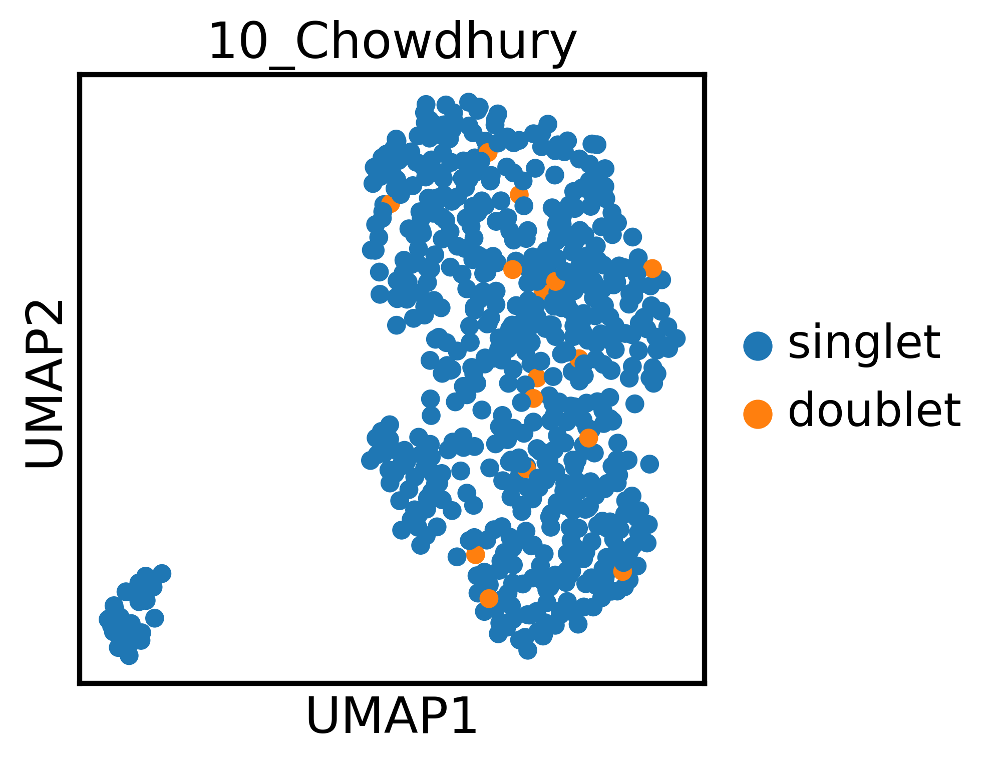

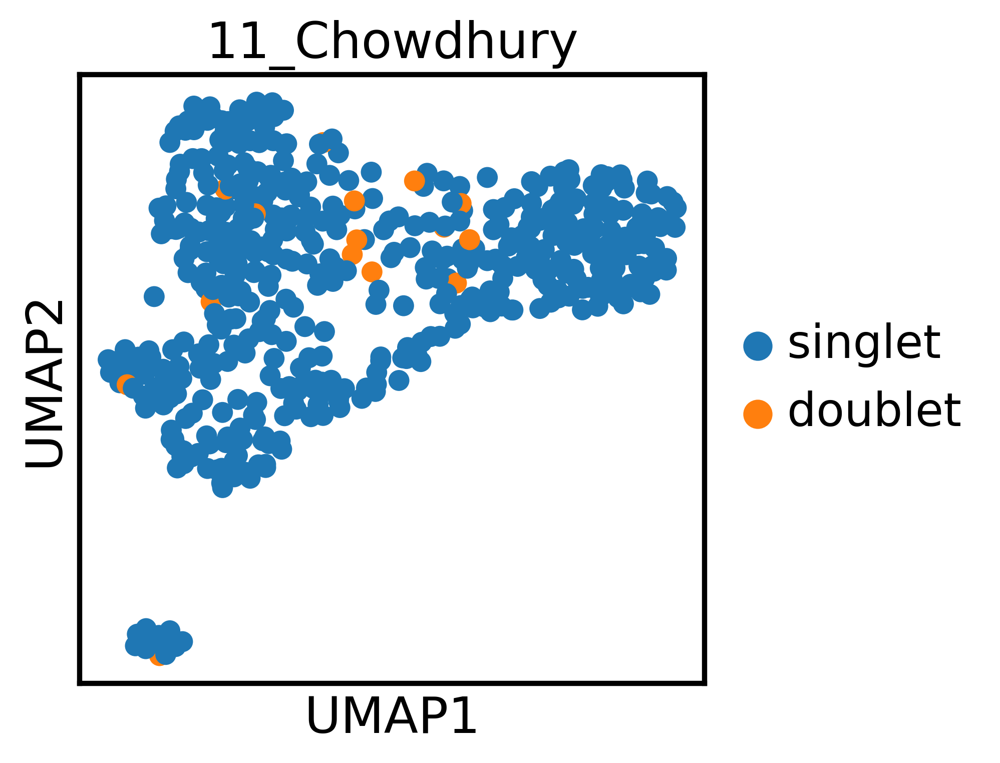

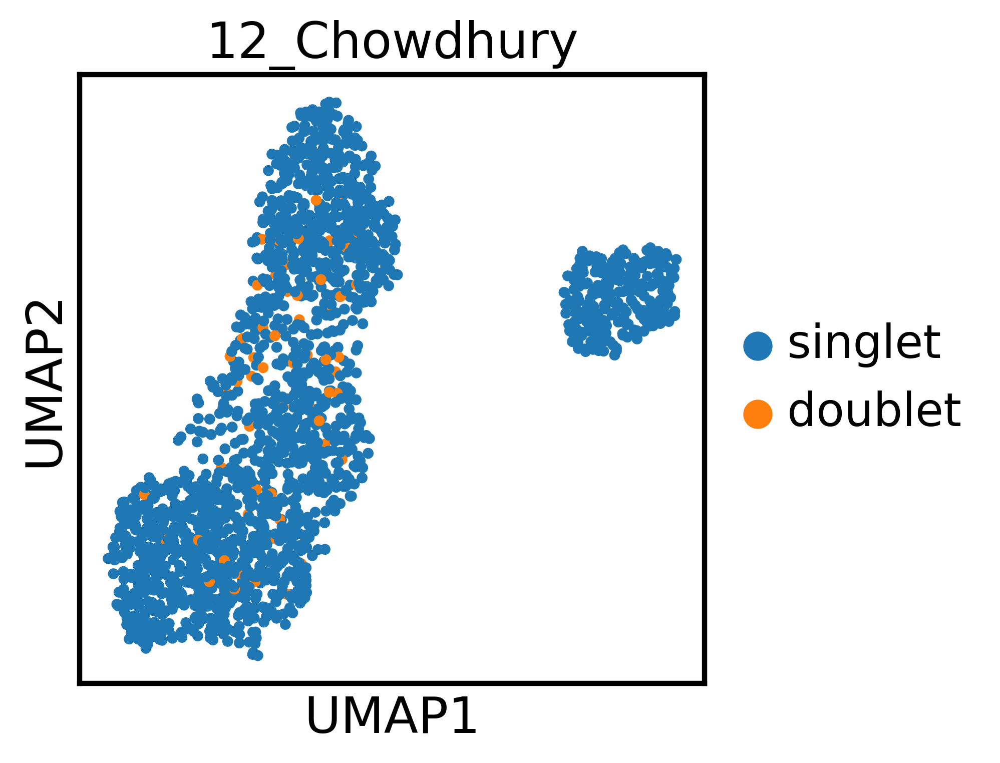

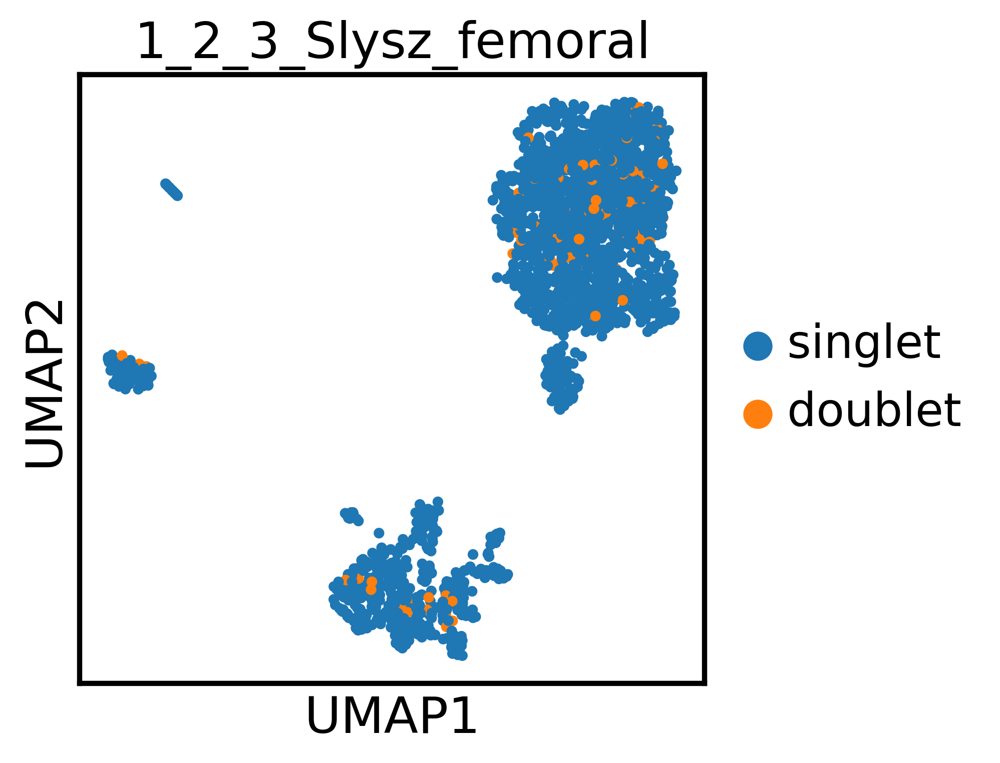

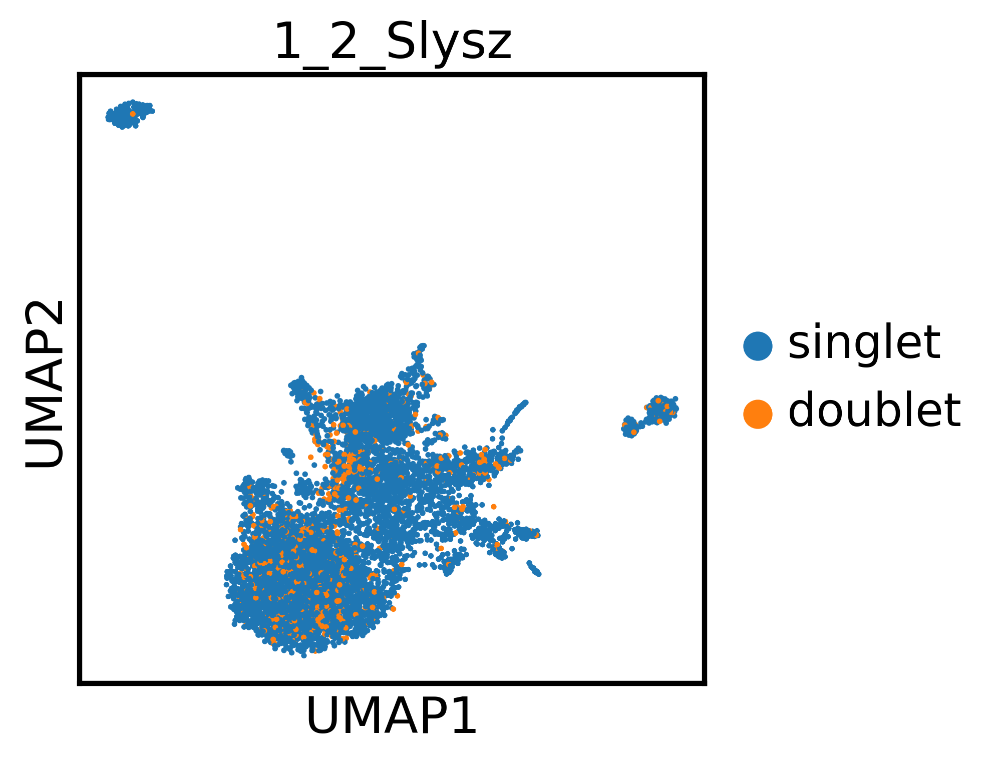

...

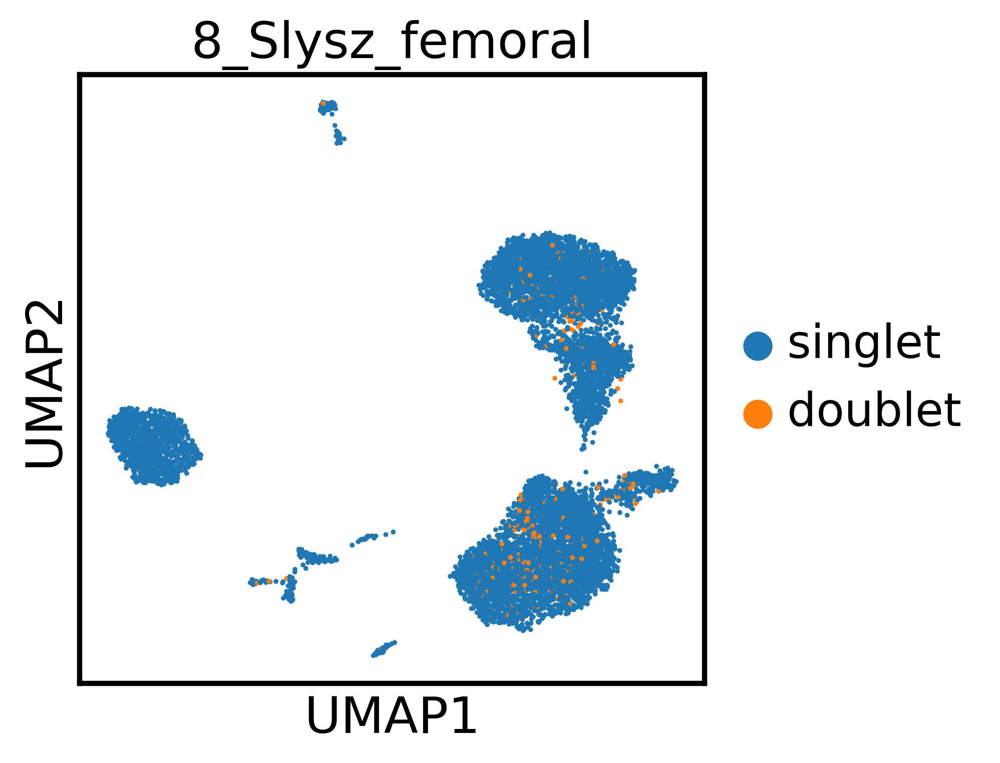

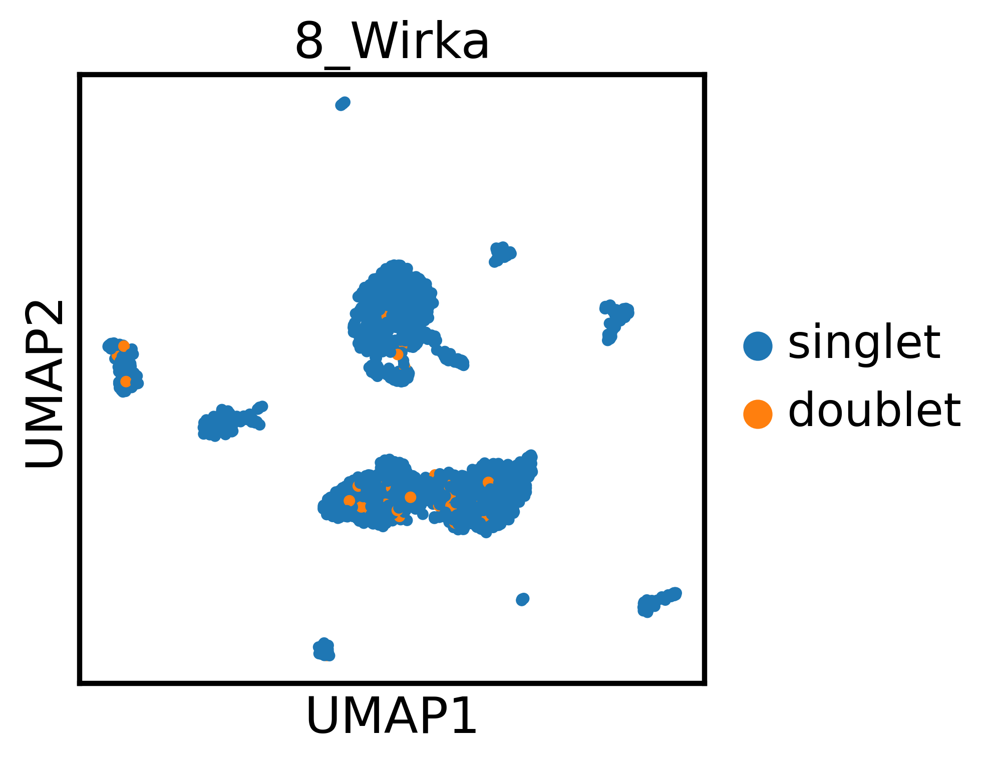

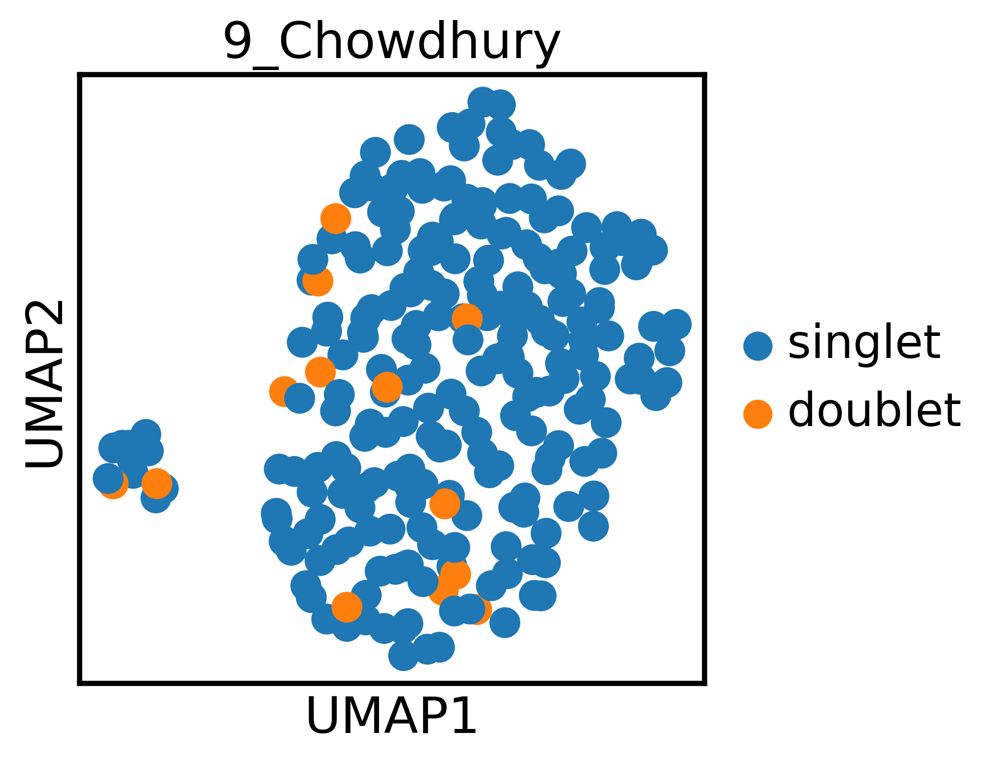

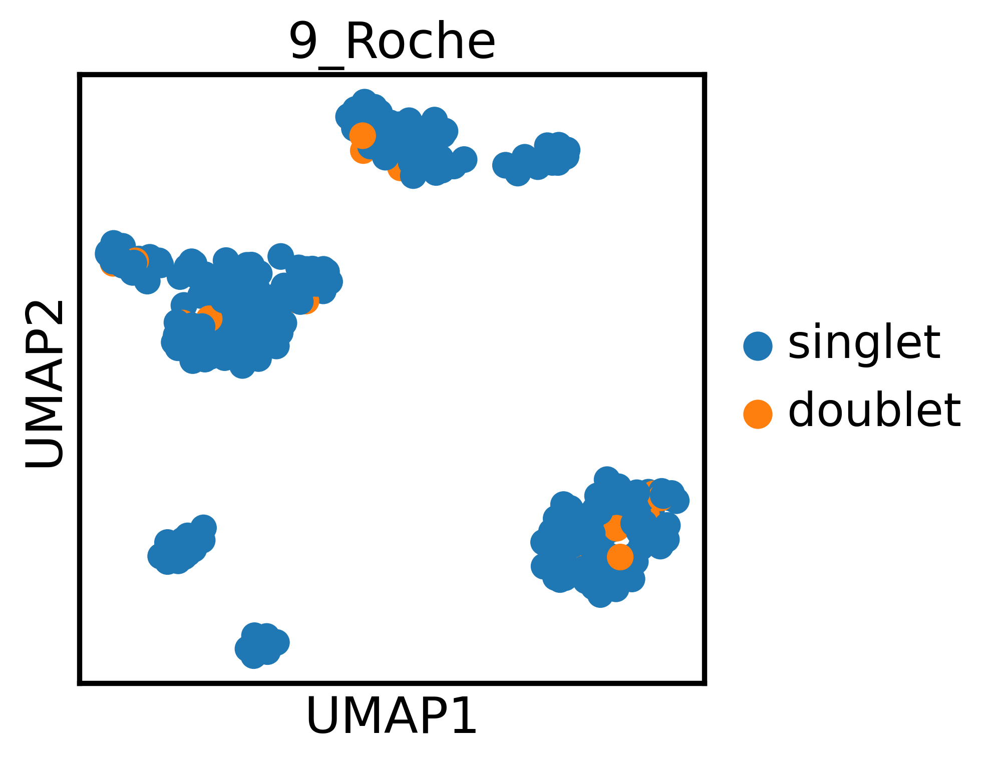

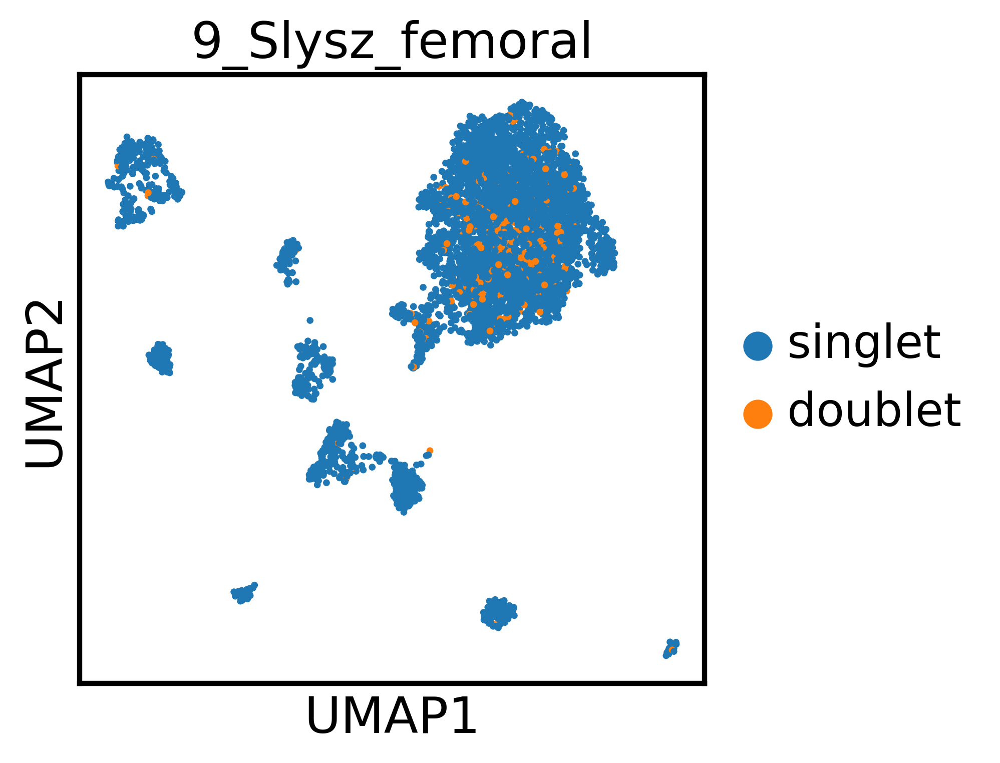

In [25]:
for sample in samples:
    fig = get_doublet_umap(adata_final, sample)
    fig.savefig("./figures/samples_umaps/doublets/{}.png".format(sample))

In [58]:
#doublets to investigate:
#3_alsaigh # in annotations this cluster was not distinct. however now (with scran on whole altas) it is and we remove it
#4_slysz # no doublets removed. cluster not unique enough
#6_slysz_femoral #in annotations not distinct enough. here also not all clusters distinct enough. only remove distinct one
#7_slysz_femoral # one cluster removed. other is not distinct enough.

### 3_alsaigh

In [52]:
adata = adata_final[adata_final.obs["sample"] == "3_Alsaigh"]

In [53]:
adata

View of AnnData object with n_obs × n_vars = 10556 × 28488
    obs: 'dataset', 'cell_type', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample', 'scDblFinder.sample', 'scDblFinder.class', 'scDblFinder.score', 'scDblFinder.weighted', 'scDblFinder.cxds_score', 'decontX_contamination', 'decontX_clusters', 'symptoms', 'n_genes', 'n_counts', 'size_factors', 'cell_type_level1'
    var: 'original_gene_names'
    uns: 'log1p'
    layers: 'raw_decontXcounts', 'rounded_corrected_counts', 'uncorrected_counts'

In [54]:
sc.pp.highly_variable_genes(adata, n_top_genes=2000, subset=False)
sc.pp.pca(adata, svd_solver="arpack", use_highly_variable=True)
sc.pp.neighbors(adata, n_pcs=30)
sc.tl.umap(adata)

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:1641: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please u

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


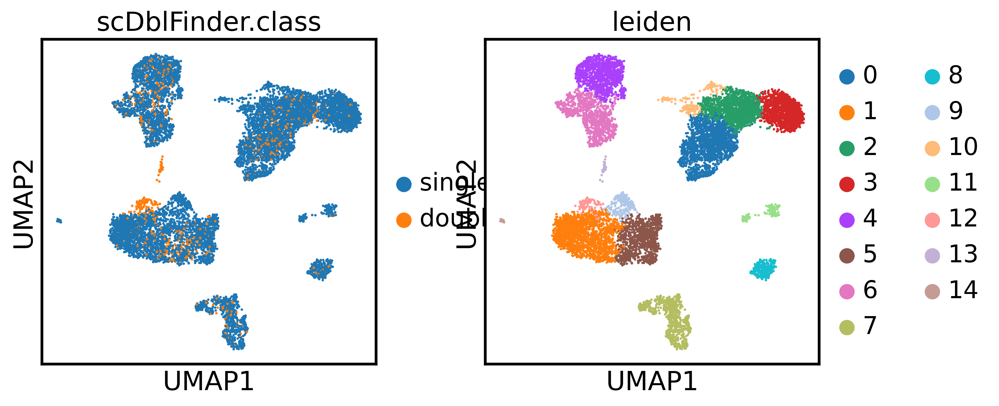

In [55]:
sc.tl.leiden(adata, resolution = 0.5)
sc.pl.umap(adata, color= ['scDblFinder.class', "leiden"])

In [56]:
# get barcodes of doublet clusters 12 and 13 
doublet_barcodes_alsaigh = adata.obs_names[adata.obs['leiden'].isin(['12', '13'])] 

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])


### 4_Sylsz

In [40]:
# almost impossible to get in distinct cluster. Hence not considered unique enough for doublet classification

In [34]:
adata = adata_final[adata_final.obs["sample"] == "4_Slysz"]

In [35]:
sc.pp.highly_variable_genes(adata, n_top_genes=2000, subset=False)
sc.pp.pca(adata, svd_solver="arpack", use_highly_variable=True)
sc.pp.neighbors(adata, n_pcs=30)
sc.tl.umap(adata)

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:1641: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please u

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


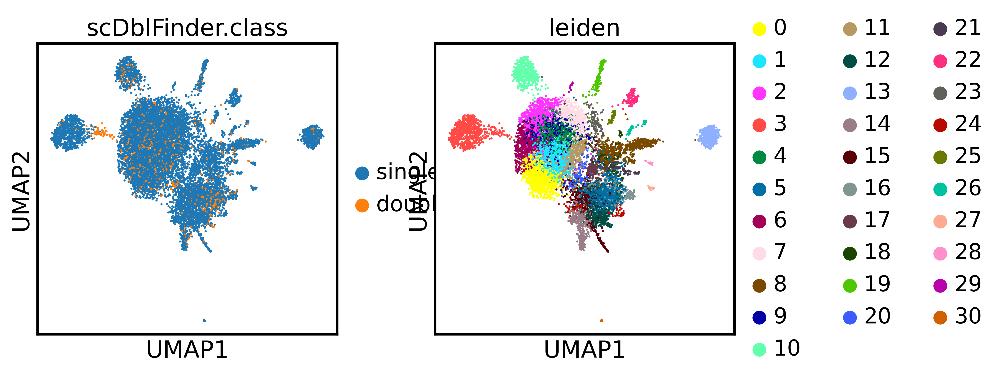

In [39]:
sc.tl.leiden(adata, resolution = 2)
sc.pl.umap(adata, color= ['scDblFinder.class', "leiden"])

### 6_Sylsz_fem

In [41]:
adata = adata_final[adata_final.obs["sample"] == "6_Slysz_femoral"]

In [42]:
sc.pp.highly_variable_genes(adata, n_top_genes=2000, subset=False)
sc.pp.pca(adata, svd_solver="arpack", use_highly_variable=True)
sc.pp.neighbors(adata, n_pcs=30)
sc.tl.umap(adata)

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:1641: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please u

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


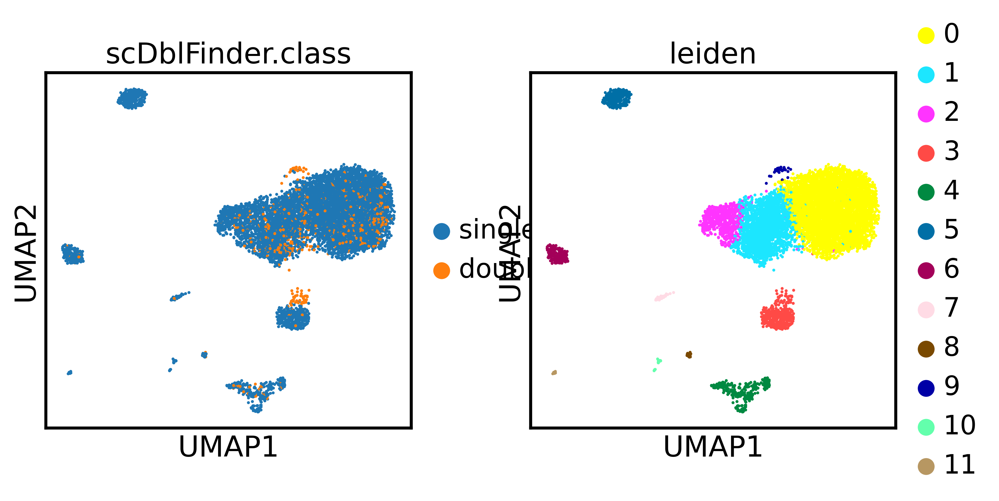

In [48]:
sc.tl.leiden(adata, resolution = 0.5)
sc.pl.umap(adata, color= ['scDblFinder.class', "leiden"])

In [50]:
# get barcodes of doublet clusters 9
doublet_barcodes_slysz6fem = adata.obs_names[adata.obs['leiden'].isin(['9'])] 

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])


In [51]:
doublet_barcodes_slysz6fem

Index(['AATCACGGTATGTGTC-1_6', 'ACAGCCGGTCTCTCCA-1_6', 'ACCACAACACGGATCC-1_6',
       'ACCTGTCTCGGATAAA-1_6', 'AGATCGTGTCCGACGT-1_6', 'ATCACTTAGGGACTGT-1_6',
       'CACTGAAAGAACTGAT-1_6', 'CACTGTCAGTGCAAAT-1_6', 'CAGATACGTGGTAATA-1_6',
       'CATAGACGTGCACAAG-1_6', 'CTACTATGTGTAAATG-1_6', 'GATCCCTTCATTTCCA-1_6',
       'GCCAACGCATCCTAAG-1_6', 'GGACGTCAGCGACTAG-1_6', 'GGGCTCACAGGAGGTT-1_6',
       'GGTCTGGCAATTCTTC-1_6', 'GTAGGTTAGATCGCCC-1_6', 'GTCACTCAGCTGTTAC-1_6',
       'GTGCGTGAGGCACTAG-1_6', 'GTTTGGAGTTCATCGA-1_6', 'TAATCTCCAGCTGTAT-1_6',
       'TCAGGGCGTGAGGAAA-1_6', 'TCAGGTATCGCTTAAG-1_6', 'TCATATCGTCCAGCGT-1_6',
       'TCCTCGAAGTTCCTGA-1_6', 'TCTGCCAAGACGAAGA-1_6', 'TGGGCTGTCAAGGAGC-1_6',
       'TTTGACTTCATGAGAA-1_6'],
      dtype='object')

### 7_Slysz_fem

In [57]:
adata = adata_final[adata_final.obs["sample"] == "7_Slysz_femoral"]

In [58]:
sc.pp.highly_variable_genes(adata, n_top_genes=2000, subset=False)
sc.pp.pca(adata, svd_solver="arpack", use_highly_variable=True)
sc.pp.neighbors(adata, n_pcs=30)
sc.tl.umap(adata)

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:1641: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please u

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


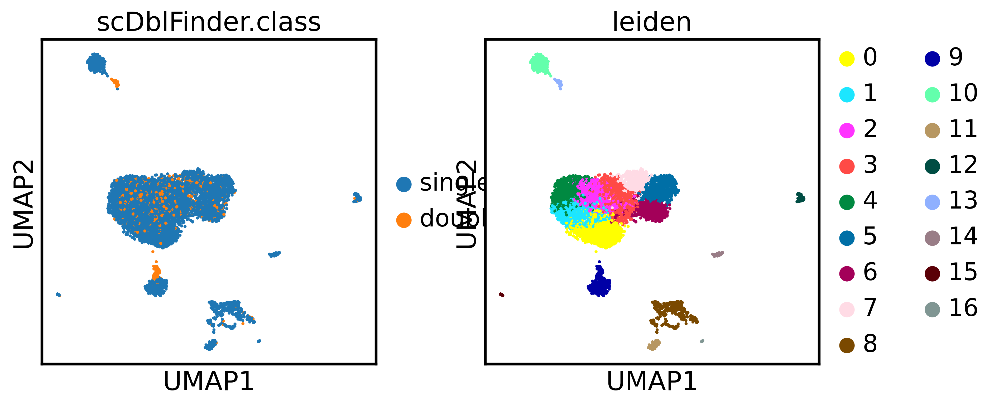

In [65]:
sc.tl.leiden(adata, resolution = 1)
sc.pl.umap(adata, color= ['scDblFinder.class', "leiden"])

In [66]:
# get barcodes of doublet cluster 13
doublet_barcodes_slysz7fem = adata.obs_names[adata.obs['leiden'].isin(['13'])] 

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])


### all of them

In [74]:
doublet_barcodes = doublet_barcodes_alsaigh.append(doublet_barcodes_slysz6fem).append(doublet_barcodes_slysz7fem).tolist()

In [75]:
pd.DataFrame(doublet_barcodes, columns=['barcodes']).to_csv('doublets_barcodes.csv', index=False)

In [77]:
adata_final.obs["cell_type_level1"].value_counts()

unknown         119818
T cell           25288
Macrophage       10743
B cell            6294
EC                5765
SMC               5244
Fibroblast        3000
NK                2670
Monocyte          2554
Fibromyocyte      1728
Mast cell          946
Plasma cell        646
DC                 626
Name: cell_type_level1, dtype: int64

In [ ]:
#assign doublet cell type to obs

In [78]:
adata_final.obs["cell_type_level1"] = ["doublets" if barcode in doublet_barcodes else cell_type for barcode, cell_type in adata_final.obs["cell_type_level1"].items()]

/tmp/ipykernel_22304/723148339.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_final.obs["cell_type_level1"] = ["doublets" if barcode in doublet_barcodes else cell_type for barcode, cell_type in adata_final.obs["cell_type_level1"].items()]


In [79]:
adata_final.obs["cell_type_level1"].value_counts()

unknown         119779
T cell           25264
Macrophage       10743
B cell            6294
EC                5765
SMC               5165
Fibroblast        3000
NK                2666
Monocyte          2522
Fibromyocyte      1701
Mast cell          946
Plasma cell        646
DC                 626
doublets           205
Name: cell_type_level1, dtype: int64

In [ ]:
# remove doublets

In [80]:
adata_final = adata_final[adata_final.obs["cell_type_level1"] != "doublets"]

In [83]:
adata_final.write_h5ad("big-datasets-concat-ensembl-nodub-newfern_with6-aggr-all-sparse-scranlog1p-annot-nodoublets.h5ad")

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/anndata/_core/anndata.py:1292: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


# Integrations

## preprocessing: HVG, PCA, checks

In [33]:
adata_final = sc.read_h5ad("big-datasets-concat-ensembl-nodub-newfern_with6-aggr-all-sparse-scranlog1p-annot-nodoublets.h5ad")

In [34]:
adata_final

AnnData object with n_obs × n_vars = 185117 × 28488
    obs: 'dataset', 'cell_type', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample', 'scDblFinder.sample', 'scDblFinder.class', 'scDblFinder.score', 'scDblFinder.weighted', 'scDblFinder.cxds_score', 'decontX_contamination', 'decontX_clusters', 'symptoms', 'n_genes', 'n_counts', 'size_factors', 'cell_type_level1'
    var: 'original_gene_names'
    uns: 'log1p'
    layers: 'raw_decontXcounts', 'rounded_corrected_counts', 'uncorrected_counts'

In [35]:
def preprocess_adata(adata_final, mode, batch_key):

    #rename layer to counts
    adata_final.layers['counts'] = adata_final.layers['rounded_corrected_counts']
    del adata_final.layers['rounded_corrected_counts']
    
    if mode=="auto":
        print("Using auto mode to do hvg and pca...")
        scib.preprocessing.reduce_data(adata_final, batch_key=batch_key)
        
    elif mode=="manual":
        print("Using manual mode to do hvg and pca...")
        sc.pp.highly_variable_genes(adata_final,  n_top_genes = 2000, batch_key = batch_key)
        sc.pp.pca(adata_final, use_highly_variable=True)

    else:
        raise ValueError("Mode must be 'auto' or 'manual'")

    
    # subset only hvgs
    print("Subset for HVGs...")
    hvg = adata_final.var[adata_final.var['highly_variable']].index.tolist()
    adata_final = adata_final[:, hvg].copy()

    
    #check how many cells have zero "counts" for all genes
    #calculated on .X, which is log-normalized (not counts)
    print("Check how many cells have zero counts for all genes...")
    cellwise_sum = adata_final.X.sum(axis=1)
    num_cells_zero_counts = (cellwise_sum == 0).sum()
    
    if num_cells_zero_counts>0:
        print(num_cells_zero_counts, " cells were found with 0 counts across all genes! Removing these cells now...")
        adata_final = adata_final[cellwise_sum > 0, :]

    
    # check for dublicate gene expressions across cells after HVG selection
    print("Check for dublicate gene expressions")
    before = adata_final.layers["counts"].toarray().shape[0]
    after = np.unique(adata_final.layers["counts"].toarray(), axis=0).shape[0]
    diff = before - after

    if diff > 0:
        print(diff, " Non unique cell expression profiles found! Removing them...")
        
        counts_array = adata_final.layers["counts"].toarray()
        # Find the indices of unique rows
        _, unique_indices = np.unique(counts_array, axis=0, return_index=True)
        # Sort the indices to maintain the original order
        unique_indices_sorted = np.sort(unique_indices)
        # Filter the AnnData object to keep only unique rows
        adata_final = adata_final[unique_indices_sorted]
    else:
        "No non unique cells found."

    
    # add atlas key (reference or query dataset)
    # unset roche cell_type_level1 obs
    adata_final.obs.loc[adata_final.obs["dataset"] == "Roche", "cell_type_level1"] = "unknown"
    
    print("Adding atlas key")
    adata_final.obs["atlas_key"] = ["query" if cell_type == "unknown" else "ref" for cell_type in adata_final.obs["cell_type_level1"]]
    
    print("Preprocessing finished!")  

    return adata_final

In [36]:
adata_pp = preprocess_adata(adata_final, mode = "auto", batch_key="sample")

Using auto mode to do hvg and pca...
HVG
Using 2 HVGs from full intersect set
Using 8 HVGs from n_batch-1 set
Using 8 HVGs from n_batch-2 set
Using 8 HVGs from n_batch-3 set
Using 6 HVGs from n_batch-4 set
Using 13 HVGs from n_batch-5 set
Using 5 HVGs from n_batch-6 set
Using 16 HVGs from n_batch-7 set
Using 13 HVGs from n_batch-8 set
Using 10 HVGs from n_batch-9 set
Using 13 HVGs from n_batch-10 set
Using 8 HVGs from n_batch-11 set
Using 15 HVGs from n_batch-12 set
Using 16 HVGs from n_batch-13 set
Using 21 HVGs from n_batch-14 set
Using 21 HVGs from n_batch-15 set
Using 13 HVGs from n_batch-16 set
Using 24 HVGs from n_batch-17 set
Using 23 HVGs from n_batch-18 set
Using 25 HVGs from n_batch-19 set
Using 17 HVGs from n_batch-20 set
Using 25 HVGs from n_batch-21 set
Using 18 HVGs from n_batch-22 set
Using 19 HVGs from n_batch-23 set
Using 19 HVGs from n_batch-24 set
Using 26 HVGs from n_batch-25 set
Using 30 HVGs from n_batch-26 set
Using 30 HVGs from n_batch-27 set
Using 34 HVGs from 

/tmp/ipykernel_1268690/27264621.py:61: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_final.obs["atlas_key"] = ["query" if cell_type == "unknown" else "ref" for cell_type in adata_final.obs["cell_type_level1"]]


Preprocessing finished!


In [40]:
adata_pp.write_h5ad("big-datasets-concat-ensembl-nodub-newfern_with6-aggr-all-sparse-scranlog1p-annot-nodoublets-pp.h5ad")

In [108]:
adata_pp

AnnData object with n_obs × n_vars = 184739 × 2000
    obs: 'dataset', 'cell_type', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample', 'scDblFinder.sample', 'scDblFinder.class', 'scDblFinder.score', 'scDblFinder.weighted', 'scDblFinder.cxds_score', 'decontX_contamination', 'decontX_clusters', 'symptoms', 'n_genes', 'n_counts', 'size_factors', 'cell_type_level1', 'atlas_key'
    var: 'original_gene_names', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'log1p', 'hvg', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'raw_decontXcounts', 'uncorrected_counts', 'counts'

## Integration with scPoli

In [2]:
adata = sc.read_h5ad("big-datasets-concat-ensembl-nodub-newfern_with6-aggr-all-sparse-scranlog1p-annot-nodoublets-pp.h5ad")

In [3]:
# Subset where atlas_key is 'ref'
adata_ref = adata[adata.obs['atlas_key'] == 'ref'].copy()

# Subset where atlas_key is 'query'
adata_query = adata[adata.obs['atlas_key'] == 'query'].copy()


In [4]:
adata_query

AnnData object with n_obs × n_vars = 120454 × 2000
    obs: 'dataset', 'cell_type', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample', 'scDblFinder.sample', 'scDblFinder.class', 'scDblFinder.score', 'scDblFinder.weighted', 'scDblFinder.cxds_score', 'decontX_contamination', 'decontX_clusters', 'symptoms', 'n_genes', 'n_counts', 'size_factors', 'cell_type_level1', 'atlas_key'
    var: 'original_gene_names', 'highly_variable'
    uns: 'log1p', 'neighbors', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts', 'raw_decontXcounts', 'uncorrected_counts'
    obsp: 'connectivities', 'distances'

In [5]:
adata_ref.obs["cell_type_level1"].value_counts()

T cell          24971
Macrophage      10567
B cell           6282
EC               5558
SMC              5021
Fibroblast       2970
NK               2589
Monocyte         2522
Fibromyocyte     1536
Mast cell         917
DC                626
Plasma cell       622
Name: cell_type_level1, dtype: int64

In [6]:
adata_query.obs["cell_type_level1"].value_counts()

unknown    120454
Name: cell_type_level1, dtype: int64

## Train reference

In [7]:
early_stopping_kwargs = {
    "early_stopping_metric": "val_prototype_loss",
    "mode": "min",
    "threshold": 0,
    "patience": 20,
    "reduce_lr": True,
    "lr_patience": 13,
    "lr_factor": 0.1,
}
    
scpoli_model = scPoli(
adata=adata_ref,
condition_keys="sample",
cell_type_keys="cell_type_level1",
embedding_dims=10,
recon_loss='mse',
)

scpoli_model.train(
    n_epochs=50,
    pretraining_epochs=40,
    early_stopping_kwargs=early_stopping_kwargs,
    eta=5,
)

Embedding dictionary:
 	Num conditions: [11]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 2000 45 10
	Mean/Var Layer in/out: 45 10
Decoder Architecture:
	First Layer in, out and cond:  10 45 10
	Output Layer in/out:  45 2000 

Initializing dataloaders
Starting training
 |████████████████████| 100.0%  - val_loss:  161.18 - val_cvae_loss:  150.89 - val_prototype_loss:   10.28 - val_labeled_loss:    2.06


In [8]:
scpoli_model.save("models/refmse3", overwrite=True)

## Reference mapping of unlabeled query dataset

In [9]:
scpoli_query = scPoli.load_query_data(
    adata=adata_query,
    reference_model=scpoli_model,
    labeled_indices=[],
)

Embedding dictionary:
 	Num conditions: [61]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 2000 45 10
	Mean/Var Layer in/out: 45 10
Decoder Architecture:
	First Layer in, out and cond:  10 45 10
	Output Layer in/out:  45 2000 



In [10]:
scpoli_query.train(
    n_epochs=50,
    pretraining_epochs=40,
    eta=10
)

The missing labels are: {'unknown'}
Therefore integer value of those labels is set to -1
The missing labels are: {'unknown'}
Therefore integer value of those labels is set to -1
The missing labels are: {'unknown'}
Therefore integer value of those labels is set to -1
The missing labels are: {'unknown'}
Therefore integer value of those labels is set to -1
Initializing dataloaders
Starting training
 |████████████████----| 80.0%  - val_loss:  203.92 - val_cvae_loss:  203.92
Initializing unlabeled prototypes with Leiden with an unknown number of  clusters.
Clustering succesful. Found 34 clusters.
 |████████████████████| 100.0%  - val_loss:  206.99 - val_cvae_loss:  206.99 - val_prototype_loss:    0.00 - val_unlabeled_loss:    0.25


In [11]:
scpoli_query.save("models/querymse3", overwrite=True)

## Label transfer

In [12]:
adata_query.X = adata_query.X.astype("float32")

In [13]:
adata_ref.X = adata_ref.X.astype("float32")

In [14]:
results_dict = scpoli_query.classify(adata_query, scale_uncertainties=True)

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scarches/models/scpoli/scpoli_model.py:454: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:261.)
  c = torch.tensor(label_tensor, device=device).T


In [19]:
#get latent representation of reference data
scpoli_query.model.eval()
data_latent_source = scpoli_query.get_latent(
    adata_ref,
    mean=True
)

adata_latent_source = sc.AnnData(data_latent_source)
adata_latent_source.obs = adata_ref.obs.copy()

#get latent representation of query data
data_latent= scpoli_query.get_latent(
    adata_query,
    mean=True
)

adata_latent = sc.AnnData(data_latent)
adata_latent.obs = adata_query.obs.copy()

#get label annotations
adata_latent.obs['cell_type_pred'] = results_dict['cell_type_level1']['preds'].tolist()
adata_latent.obs['cell_type_uncert'] = results_dict['cell_type_level1']['uncert'].tolist()
#adata_latent.obs['classifier_outcome'] = (adata_latent.obs['cell_type_pred'] == adata_latent.obs['cell_type_level1'])

'''
#get prototypes
labeled_prototypes = scpoli_query.get_prototypes_info()
labeled_prototypes.obs['sample'] = 'labeled prototype'
unlabeled_prototypes = scpoli_query.get_prototypes_info(prototype_set='unlabeled')
unlabeled_prototypes.obs['sample'] = 'unlabeled prototype'


#join adatas
adata_latent_full = adata_latent_source.concatenate(
    [adata_latent, labeled_prototypes, unlabeled_prototypes],
    batch_key='query'
)
'''
#join adatas
adata_latent_full = adata_latent_source.concatenate(
    [adata_latent],
    batch_key='query'
)


adata_latent_full.obs['cell_type_pred'][adata_latent_full.obs['query'].isin(['0'])] = "Reference" #np.nan

/tmp/ipykernel_306983/2101637798.py:40: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata_latent_full = adata_latent_source.concatenate(
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])
/tmp/ipykernel_306983/2101637798.py:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-ve

In [20]:
sc.pp.neighbors(adata_latent_full, n_neighbors=15)
sc.tl.umap(adata_latent_full)

In [21]:
adata_latent_full

AnnData object with n_obs × n_vars = 184635 × 10
    obs: 'dataset', 'cell_type', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample', 'scDblFinder.sample', 'scDblFinder.class', 'scDblFinder.score', 'scDblFinder.weighted', 'scDblFinder.cxds_score', 'decontX_contamination', 'decontX_clusters', 'symptoms', 'n_genes', 'n_counts', 'size_factors', 'cell_type_level1', 'atlas_key', 'conditions_combined', 'cell_type_pred', 'cell_type_uncert', 'query'
    uns: 'neighbors', 'umap'
    obsm: 'X_umap'
    obsp: 'distances', 'connectivities'

In [23]:
# Get unique categories from cell_type_pred
adata_latent_full.obs['cell_type_pred'] = adata_latent_full.obs['cell_type_pred'].astype('category')
categories = adata_latent_full.obs['cell_type_pred'].cat.categories

# Define the default Scanpy palette
default_palette = sc.pl.palettes.default_20

# Create a color palette, setting 'reference' to light gray and other categories to default colors
color_palette = {
    category: (0.84, 0.84, 0.84) if category == 'Reference' else default_palette[i % len(default_palette)]
    for i, category in enumerate(categories)
}

# Plot UMAP with custom color palette
sc.pl.umap(
    adata_latent_full,
    color='cell_type_pred',
    palette=color_palette,
    show=False,
    frameon=False,
    title = "",
    save="_mse3_cell_types_with_ref.png"
)

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


<Axes: xlabel='UMAP1', ylabel='UMAP2'>

In [26]:
sc.pl.umap(
    adata_latent_full,
    color='dataset',
    show=False,
    frameon=False,
    title="",
    save="_mse3_datasets.png"
)

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


<Axes: xlabel='UMAP1', ylabel='UMAP2'>

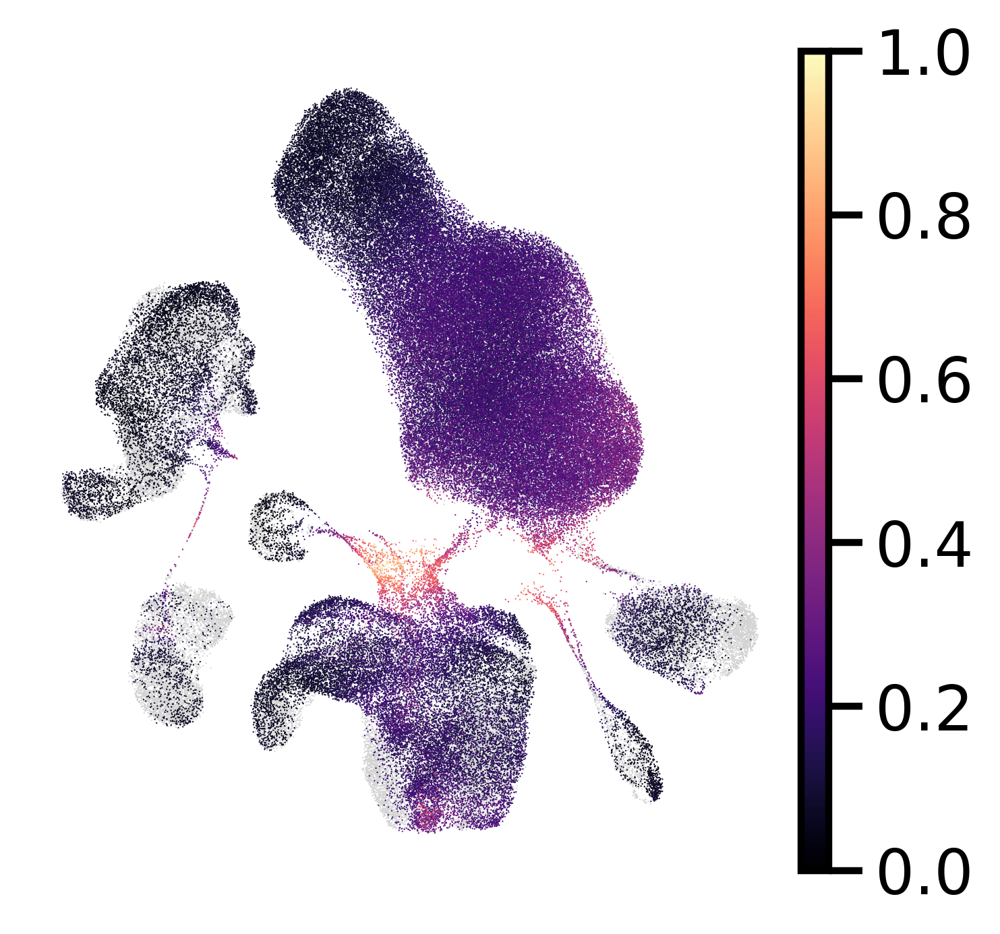

In [28]:
sc.pl.umap(
    adata_latent_full,
    color='cell_type_uncert',
    show=True,
    frameon=False,
    cmap='magma',
    vmax=1,
    title="",
    save="_mse3_uncert.png"
)

In [23]:
adata_latent_full.obs['cell_type_level1_all'] = [
    row['cell_type_level1'] if row['cell_type_pred'] == 'reference' else row['cell_type_pred'] 
    for _, row in adata_latent_full.obs.iterrows()
]

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:1641: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])


In [24]:
adata_latent_full.obs["cell_type_level1_all"].value_counts()

T cell          85475
NK              26967
Macrophage      21171
Monocyte         9087
B cell           9075
SMC              9022
EC               6613
DC               5348
Fibroblast       4980
Fibromyocyte     3405
Mast cell        1864
Plasma cell      1628
Name: cell_type_level1_all, dtype: int64

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


<Axes: title={'center': 'cell_type_level1_all'}, xlabel='UMAP1', ylabel='UMAP2'>

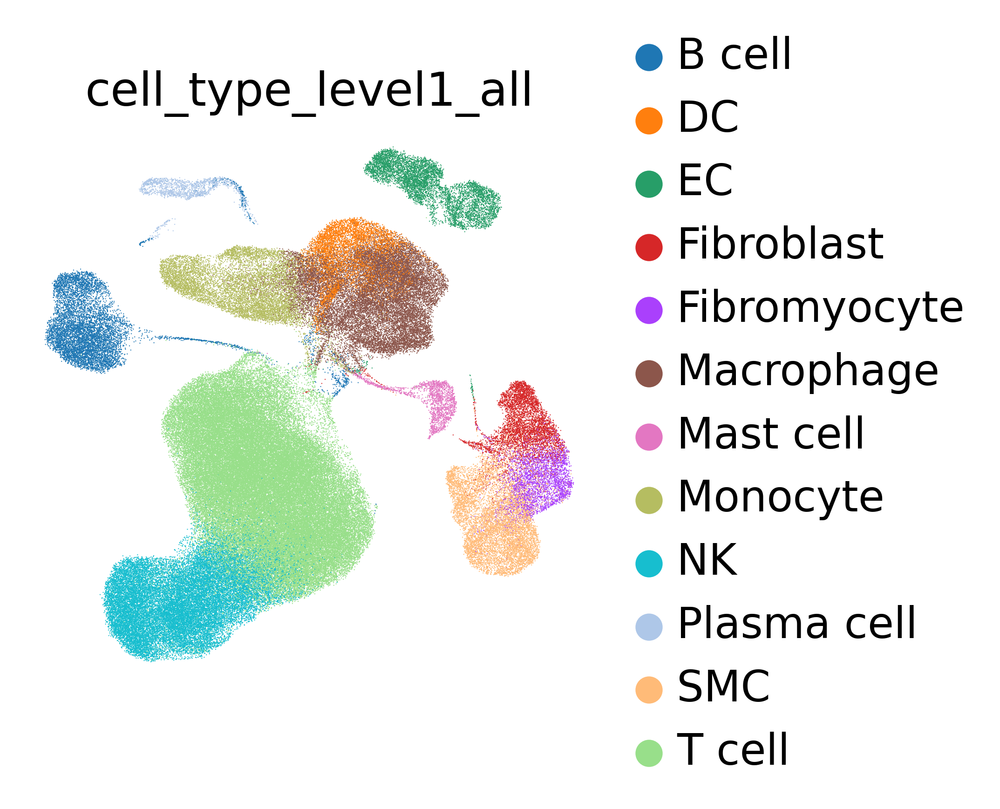

In [25]:
sc.pl.umap(
    adata_latent_full,
    color='cell_type_level1_all',
    show=False,
    frameon=False,
    #save = "cell_types_all.png"
)

In [26]:
adata_latent_full.write_h5ad("Altas_level1-noprototypes-mse-2.h5ad")

## reload model (for reproducibility)

In [4]:
scpoli_model = scPoli(
adata=adata_ref,
condition_keys="sample",
cell_type_keys="cell_type_level1",
embedding_dims=10,
recon_loss='mse',
)

Embedding dictionary:
 	Num conditions: [11]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 2000 45 10
	Mean/Var Layer in/out: 45 10
Decoder Architecture:
	First Layer in, out and cond:  10 45 10
	Output Layer in/out:  45 2000 



In [5]:
scpoli_query = scPoli.load_query_data(
    adata=adata_query,
    reference_model=scpoli_model,
    labeled_indices=[],
)

Embedding dictionary:
 	Num conditions: [61]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 2000 45 10
	Mean/Var Layer in/out: 45 10
Decoder Architecture:
	First Layer in, out and cond:  10 45 10
	Output Layer in/out:  45 2000 



In [6]:
adata_query.X = adata_query.X.astype("float32")

In [7]:
adata_ref.X = adata_ref.X.astype("float32")

In [8]:
scpoli_loaded = scpoli_query.load(dir_path="models/querymse3", adata=adata_query)

AnnData object with n_obs × n_vars = 120454 × 2000
    obs: 'dataset', 'cell_type', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample', 'scDblFinder.sample', 'scDblFinder.class', 'scDblFinder.score', 'scDblFinder.weighted', 'scDblFinder.cxds_score', 'decontX_contamination', 'decontX_clusters', 'symptoms', 'n_genes', 'n_counts', 'size_factors', 'cell_type_level1', 'atlas_key', 'conditions_combined'
    var: 'original_gene_names', 'highly_variable'
    uns: 'log1p', 'neighbors', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts', 'raw_decontXcounts', 'uncorrected_counts'
    obsp: 'connectivities', 'distances'
Embedding dictionary:
 	Num conditions: [61]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 2000 45 10
	Mean/Var Layer in/out: 45 10
Decoder Architecture:
	First Layer in, out and cond:  10 45 10
	Output Layer in/out:  45 2000 



In [9]:
results_dict = scpoli_loaded.classify(adata_query, scale_uncertainties=True)

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scarches/models/scpoli/scpoli_model.py:454: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:261.)
  c = torch.tensor(label_tensor, device=device).T


In [10]:
#get latent representation of reference data
scpoli_loaded.model.eval()
data_latent_source = scpoli_loaded.get_latent(
    adata_ref,
    mean=True
)

adata_latent_source = sc.AnnData(data_latent_source)
adata_latent_source.obs = adata_ref.obs.copy()

#get latent representation of query data
data_latent= scpoli_loaded.get_latent(
    adata_query,
    mean=True
)

adata_latent = sc.AnnData(data_latent)
adata_latent.obs = adata_query.obs.copy()

#get label annotations
adata_latent.obs['cell_type_pred'] = results_dict['cell_type_level1']['preds'].tolist()
adata_latent.obs['cell_type_uncert'] = results_dict['cell_type_level1']['uncert'].tolist()
#adata_latent.obs['classifier_outcome'] = (adata_latent.obs['cell_type_pred'] == adata_latent.obs['cell_type_level1'])

'''
#get prototypes
labeled_prototypes = scpoli_query.get_prototypes_info()
labeled_prototypes.obs['sample'] = 'labeled prototype'
unlabeled_prototypes = scpoli_query.get_prototypes_info(prototype_set='unlabeled')
unlabeled_prototypes.obs['sample'] = 'unlabeled prototype'


#join adatas
adata_latent_full = adata_latent_source.concatenate(
    [adata_latent, labeled_prototypes, unlabeled_prototypes],
    batch_key='query'
)
'''
#join adatas
adata_latent_full = adata_latent_source.concatenate(
    [adata_latent],
    batch_key='query'
)


adata_latent_full.obs['cell_type_pred'][adata_latent_full.obs['query'].isin(['0'])] = "Reference" #np.nan

/tmp/ipykernel_1605294/412951558.py:40: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata_latent_full = adata_latent_source.concatenate(
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])
/tmp/ipykernel_1605294/412951558.py:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-ve

In [11]:
sc.pp.neighbors(adata_latent_full, n_neighbors=15)
sc.tl.umap(adata_latent_full)

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


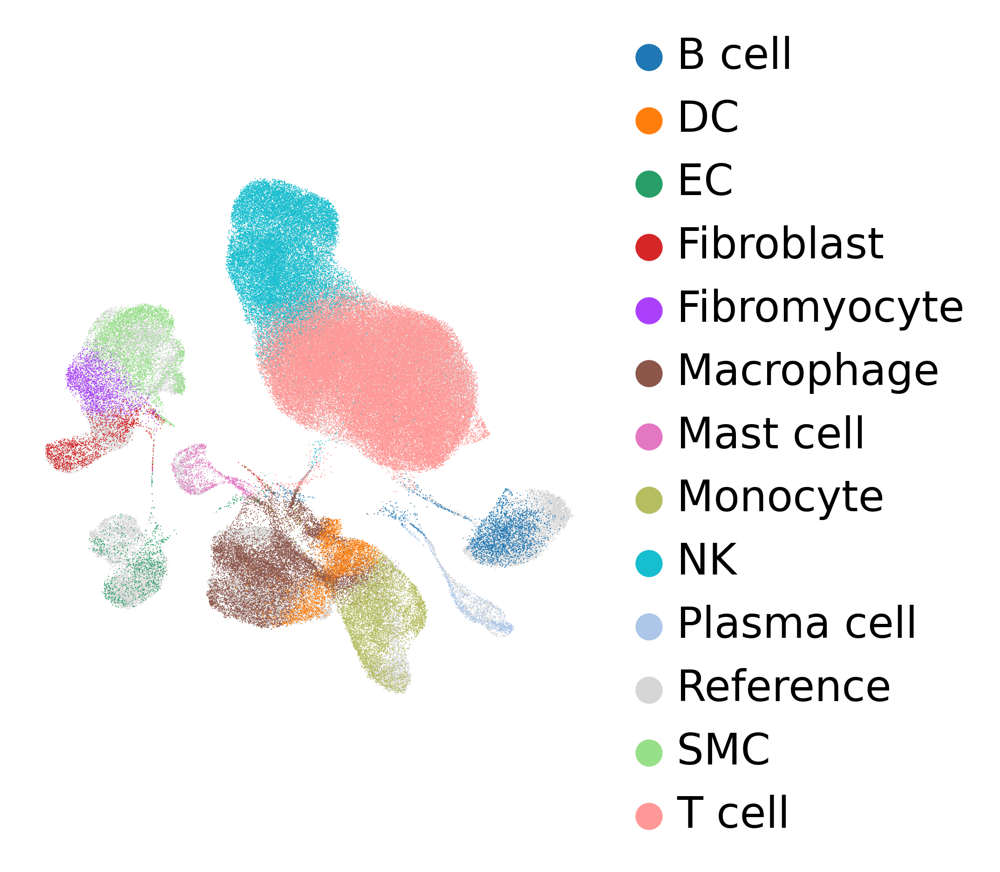

In [12]:
# Get unique categories from cell_type_pred
adata_latent_full.obs['cell_type_pred'] = adata_latent_full.obs['cell_type_pred'].astype('category')
categories = adata_latent_full.obs['cell_type_pred'].cat.categories

# Define the default Scanpy palette
default_palette = sc.pl.palettes.default_20

# Create a color palette, setting 'reference' to light gray and other categories to default colors
color_palette = {
    category: (0.84, 0.84, 0.84) if category == 'Reference' else default_palette[i % len(default_palette)]
    for i, category in enumerate(categories)
}

# Plot UMAP with custom color palette
sc.pl.umap(
    adata_latent_full,
    color='cell_type_pred',
    palette=color_palette,
    show=True,
    frameon=False,
    title = "",
    #save="_mse3_cell_types_with_ref.png"
)

In [13]:
adata_latent_full.obs['cell_type_level1_all'] = [
    row['cell_type_level1'] if row['cell_type_pred'] == 'Reference' else row['cell_type_pred'] 
    for _, row in adata_latent_full.obs.iterrows()
]

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:1641: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])


/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


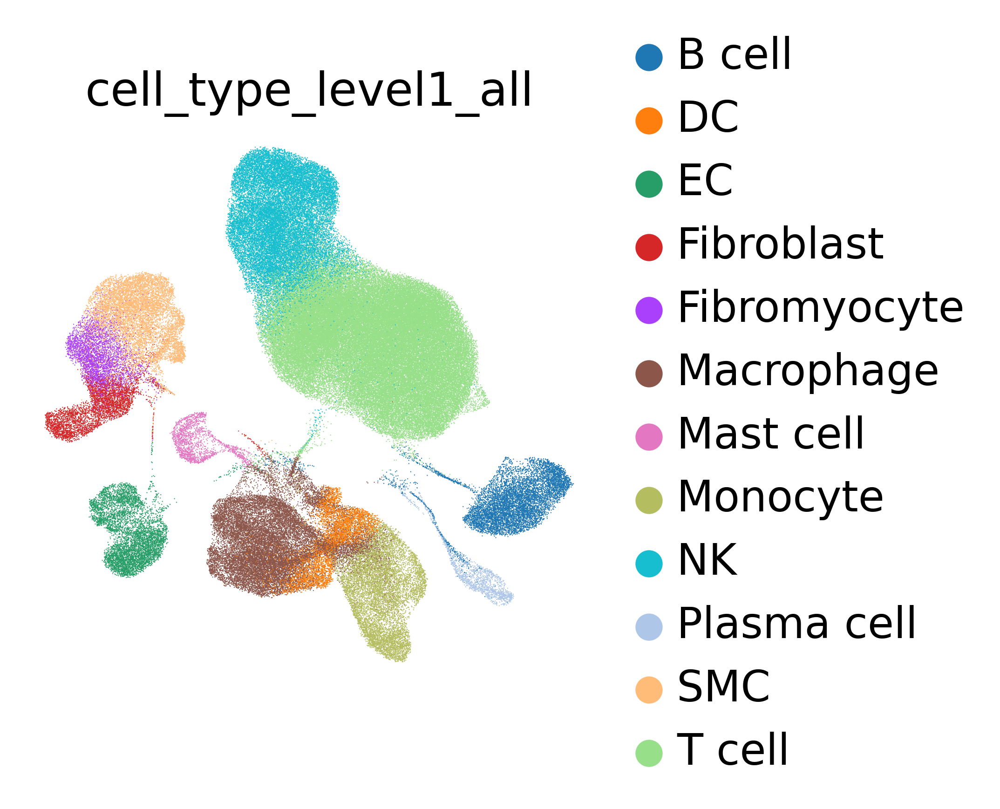

In [14]:
sc.pl.umap(
    adata_latent_full,
    color='cell_type_level1_all',
    show=True,
    frameon=False,
    #save = "cell_types_all.png"
)

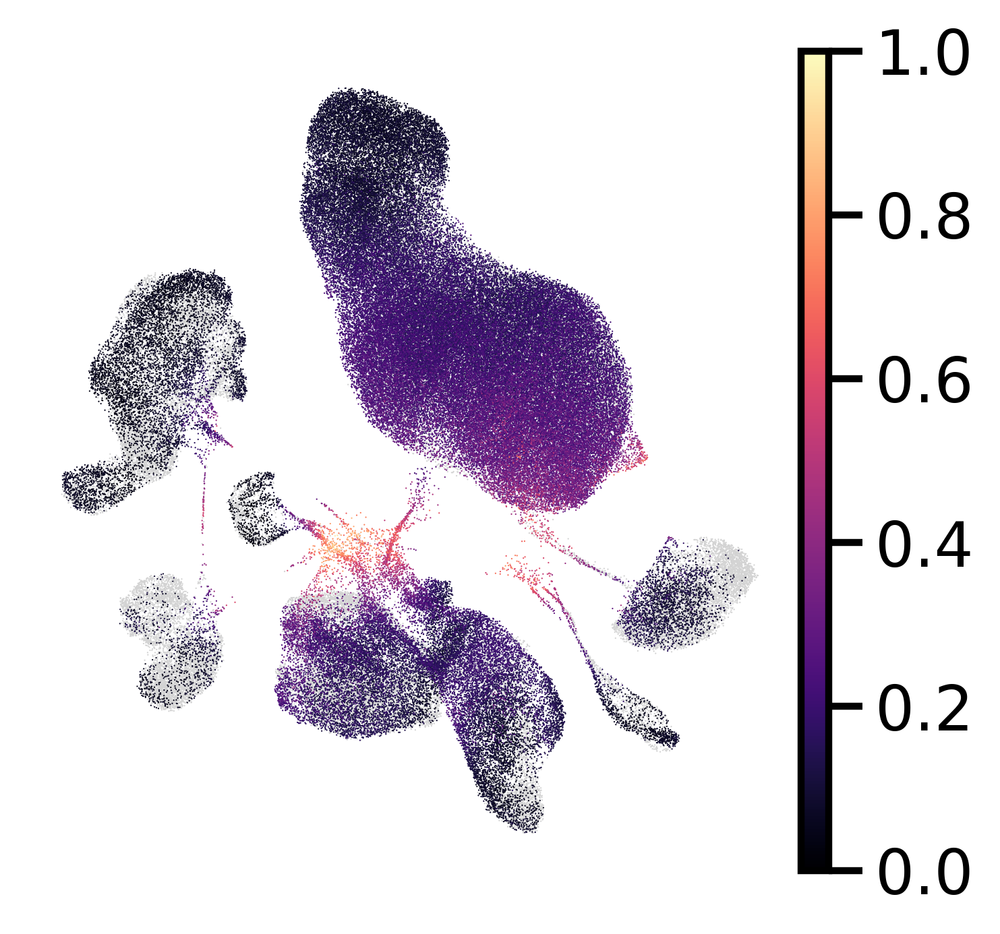

In [15]:
sc.pl.umap(
    adata_latent_full,
    color='cell_type_uncert',
    show=True,
    frameon=False,
    cmap='magma',
    vmax=1,
    title="",
    #save="_mse3_uncert.png"
)

In [ ]:
adata_latent_full.write_h5ad("Altas_level1-noprototypes-mse-3-reload.h5ad")

In [3]:
adata_latent_full = sc.read_h5ad("Altas_level1-noprototypes-mse-3-reload.h5ad")

In [4]:
adata_latent_full

AnnData object with n_obs × n_vars = 184635 × 10
    obs: 'dataset', 'cell_type', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample', 'scDblFinder.sample', 'scDblFinder.class', 'scDblFinder.score', 'scDblFinder.weighted', 'scDblFinder.cxds_score', 'decontX_contamination', 'decontX_clusters', 'symptoms', 'n_genes', 'n_counts', 'size_factors', 'cell_type_level1', 'atlas_key', 'conditions_combined', 'cell_type_pred', 'cell_type_uncert', 'query', 'cell_type_level1_all'
    uns: 'cell_type_level1_all_colors', 'cell_type_pred_colors', 'neighbors', 'umap'
    obsm: 'X_umap'
    obsp: 'connectivities', 'distances'

In [8]:
adata_latent_full[adata_latent_full.obs['cell_type_uncert'] > 0.7]

View of AnnData object with n_obs × n_vars = 476 × 10
    obs: 'dataset', 'cell_type', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample', 'scDblFinder.sample', 'scDblFinder.class', 'scDblFinder.score', 'scDblFinder.weighted', 'scDblFinder.cxds_score', 'decontX_contamination', 'decontX_clusters', 'symptoms', 'n_genes', 'n_counts', 'size_factors', 'cell_type_level1', 'atlas_key', 'conditions_combined', 'cell_type_pred', 'cell_type_uncert', 'query', 'cell_type_level1_all'
    uns: 'cell_type_level1_all_colors', 'cell_type_pred_colors', 'neighbors', 'umap'
    obsm: 'X_umap'
    obsp: 'connectivities', 'distances'

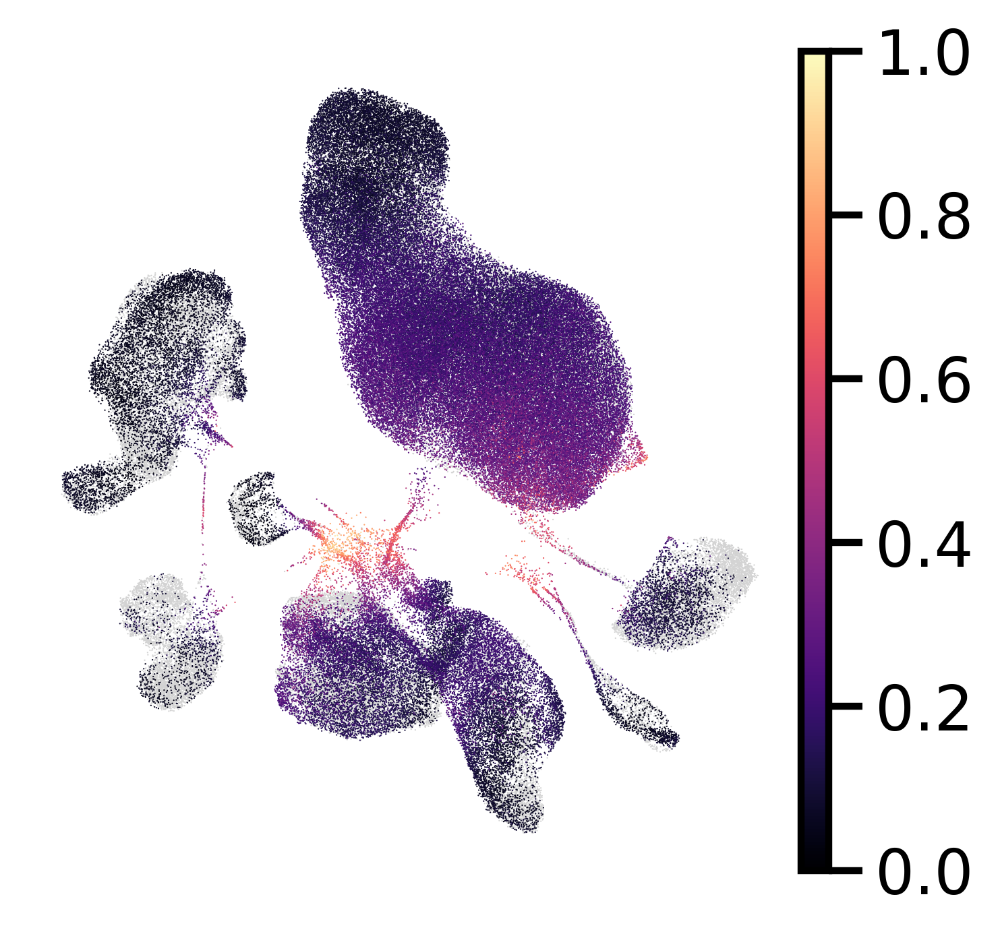

In [9]:
sc.pl.umap(
    adata_latent_full,
    color='cell_type_uncert',
    show=True,
    frameon=False,
    cmap='magma',
    vmax=1,
    title="",
    #save="_mse3_uncert.png"
)

# Transfer labels to all genes adata

In [31]:
adata_post_int = sc.read_h5ad("Altas_level1-noprototypes-mse-3-reload.h5ad")

In [32]:
adata_post_int.obs_names = adata_post_int.obs_names.str[:-2]

In [33]:
adata_pre_pp = sc.read_h5ad("big-datasets-concat-ensembl-nodub-newfern_with6-aggr-all-sparse-scranlog1p-annot-nodoublets.h5ad")

In [34]:
adata_post_int.obs

,dataset,cell_type,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,sample,scDblFinder.sample,scDblFinder.class,scDblFinder.score,...,n_genes,n_counts,size_factors,cell_type_level1,atlas_key,conditions_combined,cell_type_pred,cell_type_uncert,query,cell_type_level1_all
AAACCCAAGATTAGAC-2,Alsaigh,NaN,2525.0,9228.0,233.0,2.524924,1_Alsaigh,1,doublet,0.999987,...,2525.0,NaN,1.618519,Macrophage,ref,1_Alsaigh,Reference,NaN,0,Macrophage
AAACCCAAGCATGTTC-2,Alsaigh,NaN,1314.0,4339.0,167.0,3.848813,1_Alsaigh,1,singlet,0.290187,...,1314.0,NaN,1.049903,T cell,ref,1_Alsaigh,Reference,NaN,0,T cell
AAACCCAAGCCTGTCG-2,Alsaigh,NaN,473.0,1123.0,85.0,7.569012,1_Alsaigh,1,singlet,0.000195,...,473.0,NaN,0.235316,T cell,ref,1_Alsaigh,Reference,NaN,0,T cell
AAACCCAAGGGTTTCT-2,Alsaigh,NaN,2198.0,7083.0,120.0,1.694197,1_Alsaigh,1,singlet,0.080428,...,2198.0,NaN,1.759374,Macrophage,ref,1_Alsaigh,Reference,NaN,0,Macrophage
AAACCCAAGTGCACCC-2,Alsaigh,NaN,2296.0,9338.0,172.0,1.841936,1_Alsaigh,1,doublet,0.580069,...,2296.0,NaN,2.051374,Macrophage,ref,1_Alsaigh,Reference,NaN,0,Macrophage
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Fresh_DTAN_4047_TTTGTCAAGGACTGGT-1,Jaiswal,CD8+ T-cells,1254.0,3224.0,108.0,3.349876,2_Jaiswal,2,singlet,0.043425,...,1254.0,3224.0,0.763210,unknown,query,2_Jaiswal,NK,0.102740,1,NK
Fresh_DTAN_4047_TTTGTCAGTAGGCTGA-1,Jaiswal,CD4+ T-cells,1189.0,4195.0,126.0,3.003576,2_Jaiswal,2,singlet,0.108291,...,1189.0,4194.0,0.774646,unknown,query,2_Jaiswal,T cell,0.238857,1,T cell
Fresh_DTAN_4047_TTTGTCATCAACACAC-1,Jaiswal,CD8+ T-cells,1236.0,3195.0,54.0,1.690141,2_Jaiswal,2,singlet,0.106050,...,1236.0,3194.0,0.782079,unknown,query,2_Jaiswal,NK,0.070211,1,NK
Fresh_DTAN_4047_TTTGTCATCATAACCG-1,Jaiswal,B-cells,984.0,2843.0,91.0,3.200844,2_Jaiswal,2,singlet,0.002852,...,984.0,2840.0,0.553815,unknown,query,2_Jaiswal,B cell,0.121851,1,B cell


In [35]:
adata_pre_pp.obs

,dataset,cell_type,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,sample,scDblFinder.sample,scDblFinder.class,scDblFinder.score,scDblFinder.weighted,scDblFinder.cxds_score,decontX_contamination,decontX_clusters,symptoms,n_genes,n_counts,size_factors,cell_type_level1
car02_d_AAATGGATCGAGTGGA.1,Roche,CD8 T,647.0,1273.0,78.0,6.127258,2_Roche,2,singlet,0.507475,1.000000,0.014949,0.000529,2-1,NaN,NaN,NaN,0.306150,T cell
car02_d_AAGGAATGTCGTTGGC.1,Roche,Inf MΦ,2881.0,9727.0,1564.0,16.078955,2_Roche,2,singlet,0.563011,1.000000,0.126022,0.024352,2-2,NaN,NaN,NaN,2.219434,Macrophage
car02_d_AATGGCTTCTTCCAGC.1,Roche,TREM2 MΦ,4906.0,43494.0,3031.0,6.968777,2_Roche,2,doublet,0.675130,0.973690,0.390259,0.000323,2-2,NaN,NaN,NaN,9.472461,Macrophage
car02_d_ACCTACCGTTTACTGG.1,Roche,Plasma cell,335.0,8015.0,3.0,0.037430,2_Roche,2,singlet,0.501177,1.000000,0.002354,0.000003,2-2,NaN,NaN,NaN,0.099273,Plasma cell
car02_d_ACCTGAAGTCATCCCT.1,Roche,Mast cell,1113.0,2843.0,219.0,7.703130,2_Roche,2,singlet,0.520772,1.000000,0.041544,0.753178,2-2,NaN,NaN,NaN,0.092680,Mast cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Fresh_DTAN_4047_TTTGTCAAGGACTGGT-1,Jaiswal,CD8+ T-cells,1254.0,3224.0,108.0,3.349876,2_Jaiswal,2,singlet,0.043425,0.733000,0.009147,0.026254,2-4,not stated,1254.0,3224.0,0.763210,unknown
Fresh_DTAN_4047_TTTGTCAGTAGGCTGA-1,Jaiswal,CD4+ T-cells,1189.0,4195.0,126.0,3.003576,2_Jaiswal,2,singlet,0.108291,0.677275,0.024988,0.003678,2-5,not stated,1189.0,4194.0,0.774646,unknown
Fresh_DTAN_4047_TTTGTCATCAACACAC-1,Jaiswal,CD8+ T-cells,1236.0,3195.0,54.0,1.690141,2_Jaiswal,2,singlet,0.106050,0.705021,0.037757,0.054584,2-7,not stated,1236.0,3194.0,0.782079,unknown
Fresh_DTAN_4047_TTTGTCATCATAACCG-1,Jaiswal,B-cells,984.0,2843.0,91.0,3.200844,2_Jaiswal,2,singlet,0.002852,0.311139,0.000223,0.015132,2-9,not stated,984.0,2840.0,0.553815,unknown


In [36]:
# Assuming 'obs_names' is the column that represents your observations. Should be just the post int obs
common_obs = adata_pre_pp.obs_names[adata_pre_pp.obs_names.isin(adata_post_int.obs_names)]

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])


In [38]:
# Create a subset of adata_pre_pp for easier handling
adata_pre_pp_subset = adata_pre_pp[common_obs]

In [39]:
# Transfer "cell_type_level1_all" data
# We're using pandas here for simplicity, but make sure to use the correct AnnData methods if needed
adata_pre_pp_subset.obs["cell_type_level1_all"] = adata_post_int.obs["cell_type_level1_all"].reindex(common_obs)

/tmp/ipykernel_1605294/761398324.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_pre_pp_subset.obs["cell_type_level1_all"] = adata_post_int.obs["cell_type_level1_all"].reindex(common_obs)


In [40]:
adata_pre_pp_subset.obs["cell_type_level1_all"].value_counts()

T cell          87083
NK              25526
Macrophage      21652
Monocyte         9292
SMC              9243
B cell           8985
EC               6610
Fibroblast       4658
DC               4600
Fibromyocyte     3519
Mast cell        1857
Plasma cell      1610
Name: cell_type_level1_all, dtype: int64

In [41]:
adata_pre_pp_subset.write_h5ad("Altas_level1-noprototypes-allgenes-mse3-reload.h5ad")

In [42]:
adata_all = sc.read_h5ad("Altas_level1-noprototypes-allgenes-mse3-reload.h5ad")

In [43]:
adata_all.var['ensembl_id'] = adata_all.var.index
adata_all.var.index = adata_all.var['original_gene_names']

In [108]:
adata_all.var

,original_gene_names,ensembl_id
original_gene_names,,
TSPAN6,TSPAN6,ENSG00000000003
TNMD,TNMD,ENSG00000000005
DPM1,DPM1,ENSG00000000419
SCYL3,SCYL3,ENSG00000000457
C1orf112,C1orf112,ENSG00000000460
...,...,...
CU633906.5,CU633906.5,ENSG00000288187
FAM106C,FAM106C,ENSG00000288235
AC010332.3,AC010332.3,ENSG00000288253


In [44]:
adata_all.write_h5ad("Altas_level1-noprototypes-allgenes-names-mse3-reload.h5ad")